In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

In [2]:
# load the dataset
data=pd.read_csv('https://raw.githubusercontent.com/FlipRoboTechnologies/ML-Datasets/main/Grades/Grades.csv')
data

,Seat No.,PH-121,HS-101,CY-105,HS-105/12,MT-111,CS-105,CS-106,EL-102,EE-119,...,CS-312,CS-317,CS-403,CS-421,CS-406,CS-414,CS-419,CS-423,CS-412,CGPA
0,CS-97001,B-,D+,C-,C,C-,D+,D,C-,B-,...,C-,C-,C-,C-,A-,A,C-,B,A-,2.205
1,CS-97002,A,D,D+,D,B-,C,D,A,D+,...,D+,D,C,D,A-,B-,C,C,B,2.008
2,CS-97003,A,B,A,B-,B+,A,B-,B+,A-,...,B,B,A,C,A,A,A,A-,A,3.608
3,CS-97004,D,C+,D+,D,D,A-,D+,C-,D,...,D+,C,D+,C-,B-,B,C+,C+,C+,1.906
4,CS-97005,A-,A-,A-,B+,A,A,A-,B+,A,...,B-,B+,B+,B-,A-,A,A-,A-,A,3.448
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
566,CS-97567,B,A,A,A-,A+,A,A-,A-,A+,...,A-,A-,A,A,A,B+,B+,B,A,3.798
567,CS-97568,A+,A,A,A,A,A,A,A-,A,...,B+,B+,A,A,A-,B,A-,C,A-,3.772
568,CS-97569,B,A,A-,B+,A,A,A,A,A,...,A-,B,A,B+,A,C,B+,A-,A-,3.470
569,CS-97570,A,B+,D,A,D,D+,B-,C-,B-,...,D,B,B,C-,D,C,B,B-,C,2.193


In [3]:
# Check the datatypes
data.dtypes

Seat No.      object
PH-121        object
HS-101        object
CY-105        object
HS-105/12     object
MT-111        object
CS-105        object
CS-106        object
EL-102        object
EE-119        object
ME-107        object
CS-107        object
HS-205/20     object
MT-222        object
EE-222        object
MT-224        object
CS-210        object
CS-211        object
CS-203        object
CS-214        object
EE-217        object
CS-212        object
CS-215        object
MT-331        object
EF-303        object
HS-304        object
CS-301        object
CS-302        object
TC-383        object
MT-442        object
EL-332        object
CS-318        object
CS-306        object
CS-312        object
CS-317        object
CS-403        object
CS-421        object
CS-406        object
CS-414        object
CS-419        object
CS-423        object
CS-412        object
CGPA         float64
dtype: object

In [ ]:
'Here we observe that all columns is a object data type exclude target variable i.e(CGPA).'

In [4]:
column=data.columns
column

Index(['Seat No.', 'PH-121', 'HS-101', 'CY-105', 'HS-105/12', 'MT-111',
       'CS-105', 'CS-106', 'EL-102', 'EE-119', 'ME-107', 'CS-107', 'HS-205/20',
       'MT-222', 'EE-222', 'MT-224', 'CS-210', 'CS-211', 'CS-203', 'CS-214',
       'EE-217', 'CS-212', 'CS-215', 'MT-331', 'EF-303', 'HS-304', 'CS-301',
       'CS-302', 'TC-383', 'MT-442', 'EL-332', 'CS-318', 'CS-306', 'CS-312',
       'CS-317', 'CS-403', 'CS-421', 'CS-406', 'CS-414', 'CS-419', 'CS-423',
       'CS-412', 'CGPA'],
      dtype='object')

In [5]:
for col in column:
    print(data[col].value_counts())
    print(data[col].nunique())
    print('-----------------------------')

Seat No.
CS-97001    1
CS-97384    1
CS-97378    1
CS-97379    1
CS-97380    1
           ..
CS-97185    1
CS-97184    1
CS-97183    1
CS-97182    1
CS-97571    1
Name: count, Length: 571, dtype: int64
571
-----------------------------
PH-121
A-    112
A     111
B+     61
B      57
B-     56
D      44
C      33
C+     31
D+     22
A+     22
C-     19
WU      2
F       1
Name: count, dtype: int64
13
-----------------------------
HS-101
A-    82
B-    78
C     68
B     63
B+    59
C-    50
C+    47
D     45
A     38
D+    36
A+     4
F      1
Name: count, dtype: int64
12
-----------------------------
CY-105
A     177
A-    120
B+     50
B      49
B-     42
D      31
A+     31
C      19
C+     17
C-     16
D+     14
WU      3
F       1
Name: count, dtype: int64
13
-----------------------------
HS-105/12
A     96
A-    75
B+    70
B     57
D     45
C     41
B-    40
C+    39
C-    36
D+    34
A+    34
WU     2
F      1
Name: count, dtype: int64
13
-----------------------------
MT-111
A-   

In [ ]:
'''Here we conclude that CGPA is a target column and this is continuous column so we can say that this is a regressor problem.'''

In [6]:
# remove the Seat No column because this is a useless.
df=data.drop('Seat No.',axis=1)

In [7]:
df

,PH-121,HS-101,CY-105,HS-105/12,MT-111,CS-105,CS-106,EL-102,EE-119,ME-107,...,CS-312,CS-317,CS-403,CS-421,CS-406,CS-414,CS-419,CS-423,CS-412,CGPA
0,B-,D+,C-,C,C-,D+,D,C-,B-,C-,...,C-,C-,C-,C-,A-,A,C-,B,A-,2.205
1,A,D,D+,D,B-,C,D,A,D+,D,...,D+,D,C,D,A-,B-,C,C,B,2.008
2,A,B,A,B-,B+,A,B-,B+,A-,A-,...,B,B,A,C,A,A,A,A-,A,3.608
3,D,C+,D+,D,D,A-,D+,C-,D,C+,...,D+,C,D+,C-,B-,B,C+,C+,C+,1.906
4,A-,A-,A-,B+,A,A,A-,B+,A,A-,...,B-,B+,B+,B-,A-,A,A-,A-,A,3.448
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
566,B,A,A,A-,A+,A,A-,A-,A+,B+,...,A-,A-,A,A,A,B+,B+,B,A,3.798
567,A+,A,A,A,A,A,A,A-,A,A,...,B+,B+,A,A,A-,B,A-,C,A-,3.772
568,B,A,A-,B+,A,A,A,A,A,B,...,A-,B,A,B+,A,C,B+,A-,A-,3.470
569,A,B+,D,A,D,D+,B-,C-,B-,C-,...,D,B,B,C-,D,C,B,B-,C,2.193


In [8]:
# check the null values
df.isnull().sum()

PH-121        0
HS-101        0
CY-105        1
HS-105/12     1
MT-111        2
CS-105        0
CS-106        2
EL-102        2
EE-119        2
ME-107        2
CS-107        2
HS-205/20     5
MT-222        5
EE-222        7
MT-224        7
CS-210        7
CS-211        5
CS-203        5
CS-214        6
EE-217        6
CS-212        6
CS-215        6
MT-331        9
EF-303       10
HS-304       10
CS-301       10
CS-302       10
TC-383       10
MT-442       10
EL-332        9
CS-318        9
CS-306        9
CS-312       10
CS-317       12
CS-403       12
CS-421       12
CS-406       85
CS-414       13
CS-419       13
CS-423       14
CS-412       79
CGPA          0
dtype: int64

In [ ]:
'''Here almost column have some null values.'''

<Axes: >

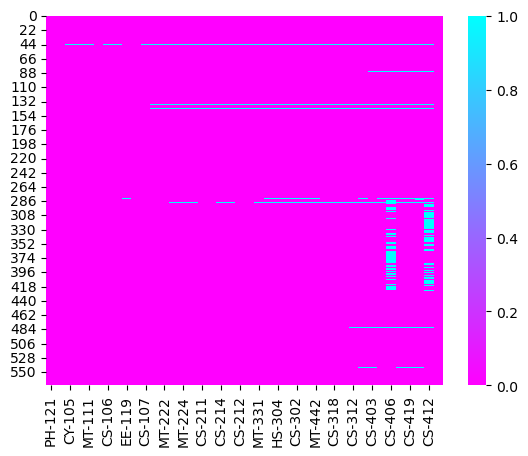

In [9]:
# visualize the null values
sns.heatmap(df.isnull(),cmap="cool_r")

In [10]:
# Check the white spaces
df.isin([' ','?','-','null','NA']).sum().any()

False

In [11]:
# Fill the null valuse with mode of its column
def fill_null(df):
    for column in df.columns:
        mode_value = df[column].mode()[0]
        df[column].fillna(mode_value, inplace=True)

# Fill null values
fill_null(df[:-1])

In [12]:
# Again check the null values
df.isnull().sum()

PH-121       0
HS-101       0
CY-105       0
HS-105/12    0
MT-111       0
CS-105       0
CS-106       0
EL-102       0
EE-119       0
ME-107       0
CS-107       0
HS-205/20    0
MT-222       0
EE-222       0
MT-224       0
CS-210       0
CS-211       0
CS-203       0
CS-214       0
EE-217       0
CS-212       0
CS-215       0
MT-331       0
EF-303       0
HS-304       0
CS-301       0
CS-302       0
TC-383       0
MT-442       0
EL-332       0
CS-318       0
CS-306       0
CS-312       0
CS-317       0
CS-403       0
CS-421       0
CS-406       0
CS-414       0
CS-419       0
CS-423       0
CS-412       0
CGPA         0
dtype: int64

In [13]:
# Checked the values counts afetr remove the null value in each column.
for col in df.columns:
    print(df[col].value_counts())
    print('-----------------------------')

PH-121
A-    112
A     111
B+     61
B      57
B-     56
D      44
C      33
C+     31
D+     22
A+     22
C-     19
WU      2
F       1
Name: count, dtype: int64
-----------------------------
HS-101
A-    82
B-    78
C     68
B     63
B+    59
C-    50
C+    47
D     45
A     38
D+    36
A+     4
F      1
Name: count, dtype: int64
-----------------------------
CY-105
A     178
A-    120
B+     50
B      49
B-     42
D      31
A+     31
C      19
C+     17
C-     16
D+     14
WU      3
F       1
Name: count, dtype: int64
-----------------------------
HS-105/12
A     97
A-    75
B+    70
B     57
D     45
C     41
B-    40
C+    39
C-    36
D+    34
A+    34
WU     2
F      1
Name: count, dtype: int64
-----------------------------
MT-111
A-    107
A     100
B-     70
B+     62
B      55
C-     39
C+     33
C      30
D      26
A+     23
D+     21
WU      3
F       2
Name: count, dtype: int64
-----------------------------
CS-105
A     151
A-    134
B+     60
B      51
A+     43
B-     38


In [14]:
# checking number of unique values in each column
df.nunique().to_frame("No. of unique vlaues")

,No. of unique vlaues
PH-121,13
HS-101,12
CY-105,13
HS-105/12,13
MT-111,13
CS-105,11
CS-106,13
EL-102,13
EE-119,12
ME-107,13


In [15]:
# check the duplicated values
df.duplicated().sum()

0

# Description of dataset

In [16]:
# Describe the data
df.describe()

,CGPA
count,571.000000
mean,2.954888
std,0.620552
min,0.800000
25%,2.538000
50%,3.029000
75%,3.451000
max,3.985000


In [17]:
# visualize the count of region
plt.figure(figsize=(40,300),facecolor='y')
col=1
for column in df:
    if(col <= 41):
        plt.subplot(21,2,col)
        sns.countplot(x=df[column],data=df)
        plt.xlabel(column,fontsize=20)
    col +=1
plt.show()

# Univariate Analysis

In [23]:
# sns.violinplot(x='PH-121', y='CGPA', data=df)
# plt.title('Violin plot of CGPA by PH-121')
# plt.show()
# visualize the Violinplot
plt.figure(figsize=(40,300),facecolor='w')
col=1
for column in df:
    if(col <= 41):
        plt.subplot(21,2,col)
        sns.violinplot(x=column, y='CGPA', data=df)
        plt.title(f'Violin plot of CGPA by {column}')
        plt.xlabel(column,fontsize=20)
    col +=1
plt.show()

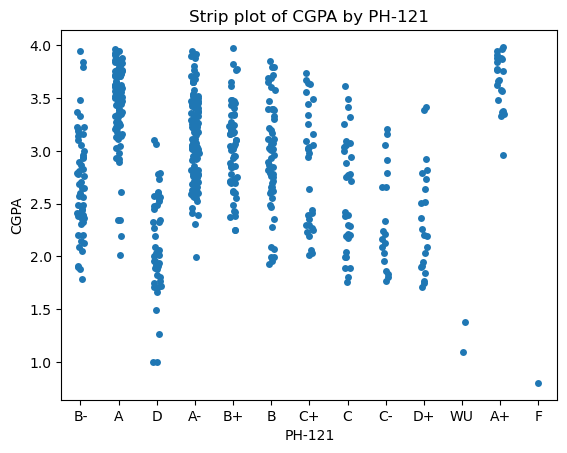

In [24]:
sns.stripplot(x='PH-121', y='CGPA', data=df, jitter=True)
plt.title('Strip plot of CGPA by PH-121')
plt.show()

# Bivariate Analysis

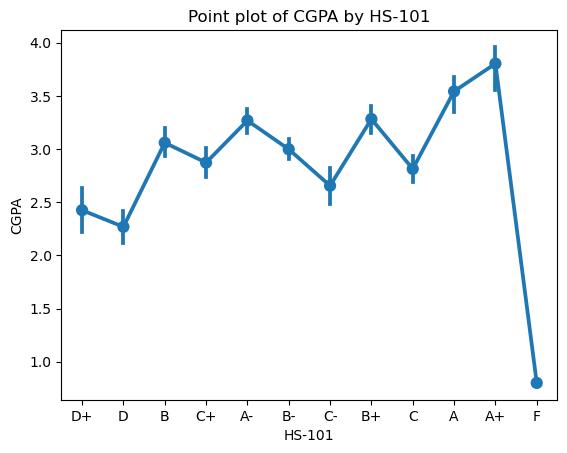

In [26]:
# Visualize the data with point plot
sns.pointplot(x='HS-101', y='CGPA', data=df)
plt.title('Point plot of CGPA by HS-101')
plt.show()

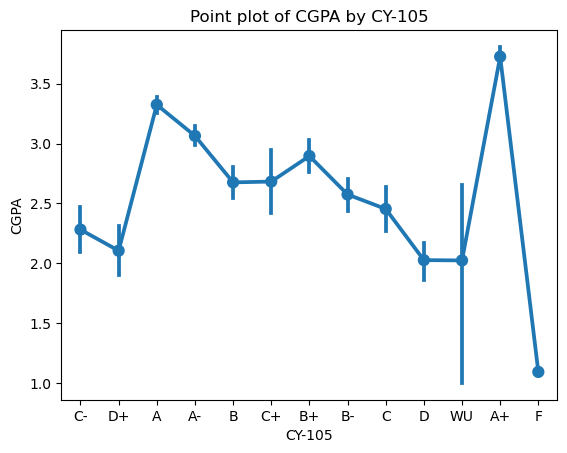

In [27]:
sns.pointplot(x='CY-105', y='CGPA', data=df)
plt.title('Point plot of CGPA by CY-105')
plt.show()

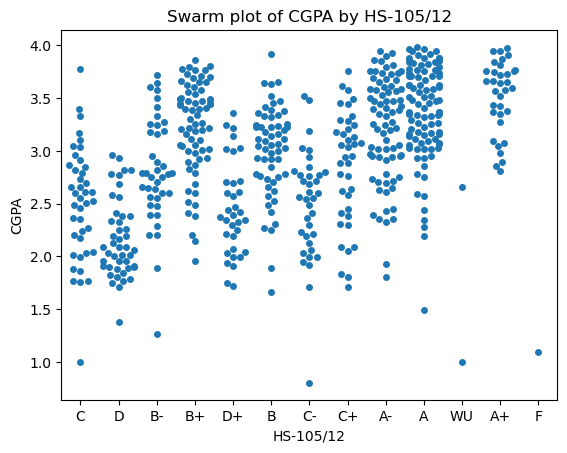

In [29]:
# Visualize with swarmplot
sns.swarmplot(x='HS-105/12', y='CGPA', data=df)
plt.title('Swarm plot of CGPA by HS-105/12')
plt.show()

# Convert the object datatype in  int datatype with LabelEncoder

In [62]:
# Encoding categorical columns using LabelEncoder
from sklearn.preprocessing import LabelEncoder
oe=LabelEncoder()
for col in df.columns:
    if(df[col].dtypes=='object'):
        df[col]=oe.fit_transform(df[col].values.reshape(-1,1))
df

,PH-121,HS-101,CY-105,HS-105/12,MT-111,CS-105,CS-106,EL-102,EE-119,ME-107,...,CS-312,CS-317,CS-403,CS-421,CS-406,CS-414,CS-419,CS-423,CS-412,CGPA
0,5,10,8,6,8,10,9,8,5,8,...,8,8,8,8,2,0,8,3,2,2.205
1,0,9,10,9,5,6,9,0,10,9,...,10,9,6,9,2,5,6,6,3,2.008
2,0,3,0,5,4,0,5,4,2,2,...,3,3,0,6,0,0,0,2,0,3.608
3,9,7,10,9,9,2,10,8,9,7,...,10,6,10,8,5,3,7,7,7,1.906
4,2,2,2,4,0,0,2,4,0,2,...,5,4,4,5,2,0,2,2,0,3.448
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
566,3,0,0,2,1,0,2,2,1,4,...,2,2,0,0,0,4,4,3,0,3.798
567,1,0,0,0,0,0,0,2,0,0,...,4,4,0,0,2,3,2,6,2,3.772
568,3,0,2,4,0,0,0,0,0,3,...,2,3,0,4,0,6,4,2,2,3.470
569,0,4,9,0,9,10,5,8,5,8,...,9,3,3,8,9,6,3,5,6,2.193


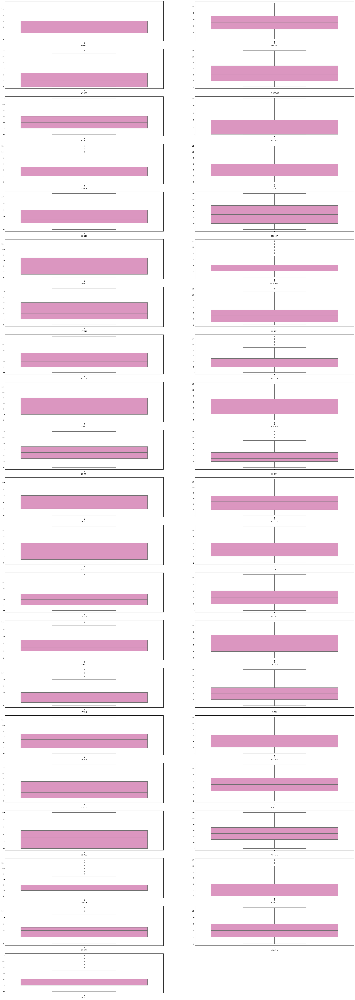

In [64]:
# lets check the outliers by plotting boxplot
plt.figure(figsize=(35,100))
p=1
for col in df:
    if p<42:
        plt.subplot(21,2,p)
        sns.boxplot(df[col],palette='Set2_r')
        plt.xlabel(col)
    p +=1
plt.show()

# Checked the skewness

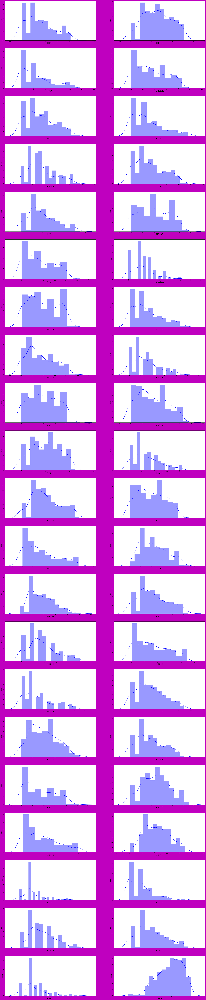

In [65]:
# checking how the data has been distributed in each column
plt.figure(figsize=(40,200),facecolor="m")
plotnumber=1
for column in df:
    if plotnumber<=42:
        ax=plt.subplot(21,2,plotnumber)
        sns.distplot(df[column],color="b")
        plt.xlabel(column,fontsize=20)
    plotnumber +=1
plt.show()

In [68]:
# Checked the skewness
df.skew()

PH-121       0.549104
HS-101       0.053303
CY-105       0.982144
HS-105/12    0.324183
MT-111       0.484906
CS-105       0.930769
CS-106       0.639845
EL-102       0.501161
EE-119       0.574880
ME-107       0.108385
CS-107       0.414846
HS-205/20    0.897186
MT-222       0.193993
EE-222       0.759105
MT-224       0.430480
CS-210       0.723967
CS-211       0.116085
CS-203       0.274205
CS-214       0.013129
EE-217       0.724325
CS-212       0.414872
CS-215       0.163631
MT-331       0.627721
EF-303       0.383655
HS-304       0.544843
CS-301       0.415084
CS-302       0.601788
TC-383       0.331652
MT-442       0.869952
EL-332       0.459160
CS-318       0.356504
CS-306       0.424753
CS-312       0.442525
CS-317       0.140692
CS-403       0.618339
CS-421       0.179508
CS-406       1.522703
CS-414       1.292931
CS-419       0.506748
CS-423       0.526550
CS-412       1.329362
CGPA        -0.497203
dtype: float64

In [ ]:
'''We found some skewness in CS-406,CS-414 ,CS-412 column'''

# Yeo-Johnson Transformation: Can handle both positive and negative values.

In [69]:
from sklearn.preprocessing import PowerTransformer
rm_skew=['CS-406','CS-414','CS-412']
pt = PowerTransformer(method='yeo-johnson')
for col in rm_skew:
    df[col] = pt.fit_transform(df[[col]])

In [70]:
# Again check the skewness
df.skew()

PH-121       0.549104
HS-101       0.053303
CY-105       0.982144
HS-105/12    0.324183
MT-111       0.484906
CS-105       0.930769
CS-106       0.639845
EL-102       0.501161
EE-119       0.574880
ME-107       0.108385
CS-107       0.414846
HS-205/20    0.897186
MT-222       0.193993
EE-222       0.759105
MT-224       0.430480
CS-210       0.723967
CS-211       0.116085
CS-203       0.274205
CS-214       0.013129
EE-217       0.724325
CS-212       0.414872
CS-215       0.163631
MT-331       0.627721
EF-303       0.383655
HS-304       0.544843
CS-301       0.415084
CS-302       0.601788
TC-383       0.331652
MT-442       0.869952
EL-332       0.459160
CS-318       0.356504
CS-306       0.424753
CS-312       0.442525
CS-317       0.140692
CS-403       0.618339
CS-421       0.179508
CS-406       0.004401
CS-414      -0.005778
CS-419       0.506748
CS-423       0.526550
CS-412       0.004089
CGPA        -0.497203
dtype: float64

# Correlation check

In [71]:
show=df.corr()

In [72]:
show

,PH-121,HS-101,CY-105,HS-105/12,MT-111,CS-105,CS-106,EL-102,EE-119,ME-107,...,CS-312,CS-317,CS-403,CS-421,CS-406,CS-414,CS-419,CS-423,CS-412,CGPA
PH-121,1.000000,0.382436,0.557843,0.498561,0.468968,0.609990,0.293963,0.423942,0.579964,0.533558,...,0.038184,0.464022,0.321264,0.290351,0.299112,0.120027,0.462770,0.094921,0.337059,-0.663135
HS-101,0.382436,1.000000,0.335074,0.473132,0.432742,0.400713,0.312019,0.349412,0.309697,0.336545,...,0.213380,0.364250,0.229546,0.301934,0.260644,0.196429,0.284668,0.228103,0.227334,-0.537170
CY-105,0.557843,0.335074,1.000000,0.510123,0.538380,0.578573,0.378223,0.447539,0.467250,0.464418,...,0.261555,0.472137,0.464575,0.349827,0.147881,0.003461,0.430053,0.120885,0.109409,-0.658282
HS-105/12,0.498561,0.473132,0.510123,1.000000,0.494731,0.482406,0.499093,0.360304,0.400303,0.320137,...,0.263143,0.478816,0.451907,0.415946,0.160855,0.139576,0.465352,0.235029,0.174749,-0.613989
MT-111,0.468968,0.432742,0.538380,0.494731,1.000000,0.393684,0.500729,0.555895,0.409161,0.471685,...,0.467946,0.555098,0.410540,0.511463,0.311991,0.224814,0.502473,0.400679,0.288612,-0.730095
CS-105,0.609990,0.400713,0.578573,0.482406,0.393684,1.000000,0.286324,0.353949,0.507357,0.455470,...,0.059711,0.387639,0.279329,0.236345,0.253899,0.096602,0.306827,0.045134,0.209720,-0.613169
CS-106,0.293963,0.312019,0.378223,0.499093,0.500729,0.286324,1.000000,0.338645,0.269895,0.281233,...,0.450752,0.416562,0.426402,0.397195,0.130763,0.100764,0.421989,0.339963,0.211657,-0.534995
EL-102,0.423942,0.349412,0.447539,0.360304,0.555895,0.353949,0.338645,1.000000,0.448908,0.461690,...,0.301324,0.466556,0.304240,0.368959,0.268626,0.243246,0.379308,0.369173,0.289507,-0.642262
EE-119,0.579964,0.309697,0.467250,0.400303,0.409161,0.507357,0.269895,0.448908,1.000000,0.572964,...,0.156809,0.445496,0.341988,0.359230,0.320200,0.201142,0.465913,0.244615,0.359602,-0.646829
ME-107,0.533558,0.336545,0.464418,0.320137,0.471685,0.455470,0.281233,0.461690,0.572964,1.000000,...,0.199848,0.462568,0.336647,0.345832,0.313898,0.146105,0.440407,0.220977,0.332648,-0.663023


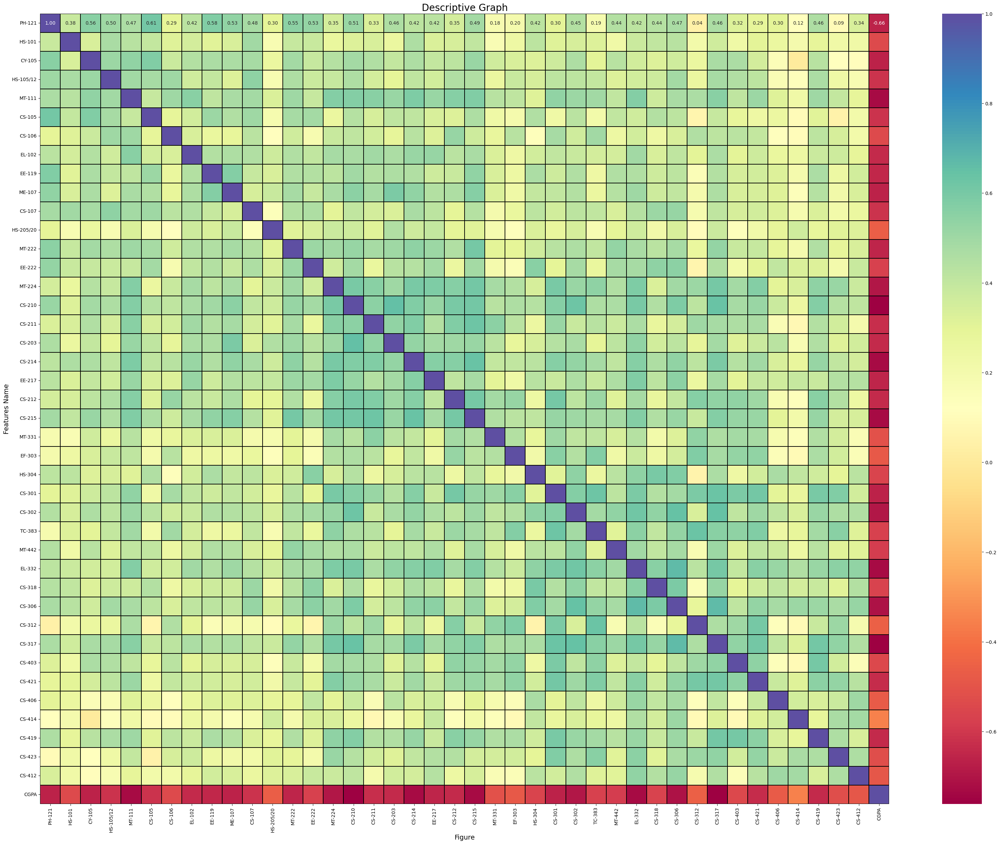

In [74]:
plt.figure(figsize=(40,30))
sns.heatmap(df.corr(),annot=True,fmt='0.2f',linewidths=0.2,linecolor='black',cmap="Spectral")
plt.xlabel('Figure',fontsize=14)
plt.ylabel('Features Name',fontsize=14)
plt.title("Descriptive Graph",fontsize=20)
plt.show()

# Separate the feature and label

In [75]:
X=df.iloc[:,:-1]
Y=df.iloc[:,-1]

In [77]:
X.shape

(571, 41)

In [78]:
Y.shape

(571,)

# Feature  Scaling using StandardScaler

In [79]:
from sklearn.preprocessing import StandardScaler
sc=StandardScaler()
X=pd.DataFrame(sc.fit_transform(X),columns=X.columns)
X

,PH-121,HS-101,CY-105,HS-105/12,MT-111,CS-105,CS-106,EL-102,EE-119,ME-107,...,CS-306,CS-312,CS-317,CS-403,CS-421,CS-406,CS-414,CS-419,CS-423,CS-412
0,0.400402,1.770900,1.722261,0.549869,1.374222,2.657832,1.790004,1.333963,0.419492,1.024565,...,0.663660,1.169315,1.155824,1.533685,0.958939,-0.222957,-1.255692,1.740513,-0.346121,-0.305331
1,-1.242052,1.411559,2.397448,1.488043,0.369509,1.173242,1.790004,-1.307365,2.302589,1.342687,...,1.715324,1.764660,1.521056,0.862110,1.325686,-0.222957,1.112272,0.900418,0.727983,0.180073
2,-1.242052,-0.744483,-0.978490,0.237145,0.034605,-1.053643,0.322008,0.013299,-0.710366,-0.884168,...,-0.738559,-0.319046,-0.670339,-1.152616,0.225444,-1.824320,-1.255692,-1.619869,-0.704156,-1.830580
3,1.714365,0.692879,2.397448,1.488043,1.709126,-0.311348,2.157003,1.333963,1.925970,0.706443,...,1.364769,1.764660,0.425358,2.205260,0.958939,0.958557,0.569191,1.320466,1.086017,1.528155
4,-0.585070,-1.103823,-0.303302,-0.075580,-1.305012,-1.053643,-0.778989,0.013299,-1.463605,-0.884168,...,-0.738559,0.276298,-0.305107,0.190534,-0.141304,-0.222957,-1.255692,-0.779774,-0.704156,-1.830580
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
566,-0.256579,-1.822504,-0.978490,-0.701029,-0.970108,-1.053643,-0.778989,-0.647033,-1.086986,-0.247924,...,-0.037450,-0.616719,-1.035572,-1.152616,-1.975041,-1.824320,0.867541,0.060322,-0.346121,-1.830580
567,-0.913561,-1.822504,-0.978490,-1.326478,-1.305012,-1.053643,-1.512987,-0.647033,-1.463605,-1.520412,...,-0.738559,-0.021374,-0.305107,-1.152616,-1.975041,-0.222957,0.569191,-0.779774,0.727983,-0.305331
568,-0.256579,-1.822504,-0.303302,-0.075580,-1.305012,-1.053643,-1.512987,-1.307365,-1.463605,-0.566046,...,-0.037450,-0.616719,-0.670339,-1.152616,-0.508051,-1.824320,1.319864,0.060322,-0.704156,-0.305331
569,-1.242052,-0.385142,2.059854,-1.326478,1.709126,2.657832,0.322008,1.333963,0.419492,1.024565,...,-0.037450,1.466987,-0.670339,-0.145253,0.958939,1.926184,1.319864,-0.359726,0.369948,1.247191


# Checking variance inflation factor

In [80]:
# Finding variance inflation factor in each scaled columnn i.e x.shape[1] (1/1-R2)
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif=pd.DataFrame()
vif["VIF values"]=[variance_inflation_factor(X.values,i) for i in range(len(X.columns))]
vif["Features"]=X.columns
vif

,VIF values,Features
0,2.848239,PH-121
1,1.768714,HS-101
2,2.516453,CY-105
3,2.299728,HS-105/12
4,2.648810,MT-111
5,2.367229,CS-105
6,1.934958,CS-106
7,1.963525,EL-102
8,2.190818,EE-119
9,2.290097,ME-107


# Modeling

In [106]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score
from sklearn.ensemble import GradientBoostingRegressor,RandomForestRegressor
from sklearn.linear_model import LinearRegression,Lasso,Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.svm import SVR
from sklearn.model_selection import cross_val_score

In [82]:
# finding the best Random State for Linear regression
max_cost_acciracy=0
random_state_max=0
for i in range(1,100):
    x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.30,random_state=i)
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    pred_accuracy=r2_score(y_test,pred)
    if(max_cost_acciracy<pred_accuracy):
        max_cost_acciracy=pred_accuracy
        random_state_max=i

print(f"Maximum r2 score is {max_cost_acciracy} on Random_state {random_state_max} ")

Maximum r2 score is 0.9630482735099115 on Random_state 19 


In [85]:
# finding the best Random State for RandomForest Regressor
max_cost_acciracy=0
random_state_max=0
for i in range(1,100):
    x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.30,random_state=i)
    rfr=RandomForestRegressor()
    rfr.fit(x_train,y_train)
    pred=rfr.predict(x_test)
    pred_accuracy=r2_score(y_test,pred)
    if(max_cost_acciracy<pred_accuracy):
        max_cost_acciracy=pred_accuracy
        random_state_max=i

print(f"Maximum r2 score is {max_cost_acciracy} on Random_state {random_state_max} ")

Maximum r2 score is 0.95767783965192 on Random_state 2 


In [86]:
'''here we observe best score with random state 19 by LinearRegressor'''

'here we observe best score with random state 19 by LinearRegressor'

In [89]:
x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.30,random_state=19)

In [91]:
# Accuracy check with Linear Regression
lr=LinearRegression()
lr.fit(x_train,y_train)
pred_lr=lr.predict(x_test)
pred_train=lr.predict(x_train)
print(lr)
print('R2_score',r2_score(y_test,pred_lr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print("Mean Absolute Error :",mean_absolute_error(y_test,pred_lr))
print("Mean Squared error: ",mean_squared_error(y_test,pred_lr))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y_test,pred_lr)))

LinearRegression()
R2_score 0.9630482735099115
R2_score on training Data: 91.17495432896872
Mean Absolute Error : 0.09467687965136579
Mean Squared error:  0.014306798437042035
Root Mean Squared Error: 0.11961102974660003


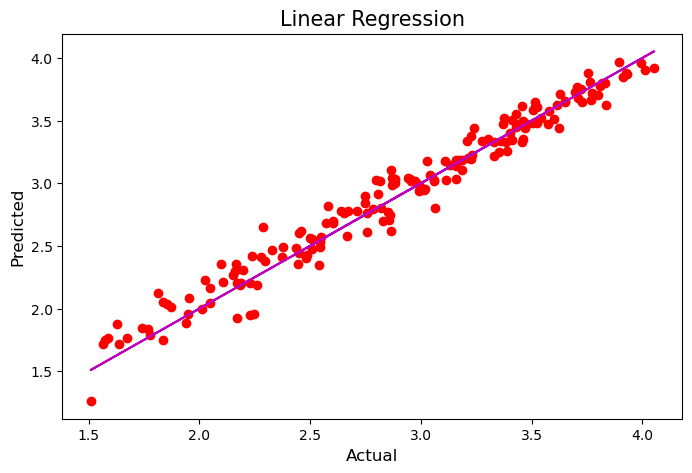

In [92]:
plt.figure(figsize=(8,5))
plt.scatter(x=pred_lr,y=y_test,color='r')
plt.plot(pred_lr,pred_lr,color='m')
plt.xlabel("Actual",fontsize=12)
plt.ylabel("Predicted",fontsize=12)
plt.title("Linear Regression",fontsize=15)
plt.show()

In [93]:
# Accuracy check with RandomForestRegressor
rfr=RandomForestRegressor()
rfr.fit(x_train,y_train)
pred_rfr=rfr.predict(x_test)
pred_train=rfr.predict(x_train)
print(rfr)
print('R2_score',r2_score(y_test,pred_rfr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print("Mean Absolute Error :",mean_absolute_error(y_test,pred_rfr))
print("Mean Squared error: ",mean_squared_error(y_test,pred_rfr))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y_test,pred_rfr)))

RandomForestRegressor()
R2_score 0.9507571611301879
R2_score on training Data: 98.52911016567127
Mean Absolute Error : 0.10420651162790694
Mean Squared error:  0.019065614440697654
Root Mean Squared Error: 0.13807829098268


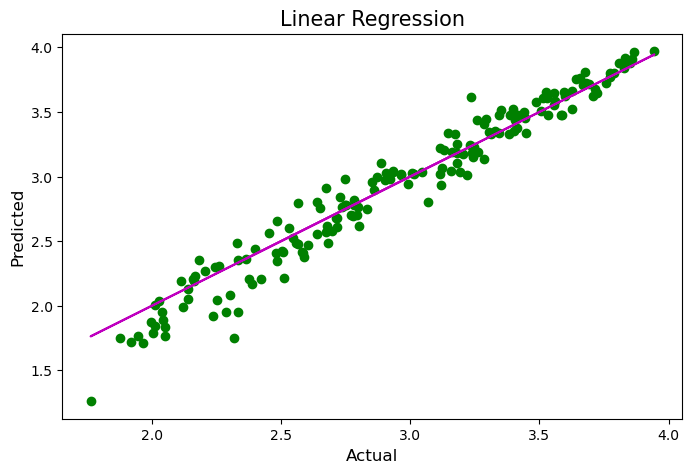

In [94]:
plt.figure(figsize=(8,5))
plt.scatter(x=pred_rfr,y=y_test,color='g')
plt.plot(pred_rfr,pred_rfr,color='m')
plt.xlabel("Actual",fontsize=12)
plt.ylabel("Predicted",fontsize=12)
plt.title("Linear Regression",fontsize=15)
plt.show()

In [95]:
# Accuracy check with KNN
knn=KNN()
knn.fit(x_train,y_train)
pred_knn=knn.predict(x_test)
pred_train=knn.predict(x_train)
print(knn)
print('R2_score',r2_score(y_test,pred_knn))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print("Mean Absolute Error :",mean_absolute_error(y_test,pred_knn))
print("Mean Squared error: ",mean_squared_error(y_test,pred_knn))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y_test,pred_knn)))

KNeighborsRegressor()
R2_score 0.9520306703808822
R2_score on training Data: 92.10280521838507
Mean Absolute Error : 0.09555000000000002
Mean Squared error:  0.018572543023255818
Root Mean Squared Error: 0.13628111763283943


In [96]:
# Accuracy check with SVR
svr=SVR()
svr.fit(x_train,y_train)
pred_svr=svr.predict(x_test)
pred_train=svr.predict(x_train)
print(svr)
print('R2_score',r2_score(y_test,pred_svr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print("Mean Absolute Error :",mean_absolute_error(y_test,pred_svr))
print("Mean Squared error: ",mean_squared_error(y_test,pred_svr))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y_test,pred_svr)))

SVR()
R2_score 0.9502421075384584
R2_score on training Data: 96.53715035977078
Mean Absolute Error : 0.09057474184336729
Mean Squared error:  0.019265030506497038
Root Mean Squared Error: 0.13879852487147346


In [97]:
# Accuracy check with GradientBoosting Regressor
gbr=GradientBoostingRegressor()
gbr.fit(x_train,y_train)
pred_gbr=gbr.predict(x_test)
pred_train=gbr.predict(x_train)
print(gbr)
print('R2_score',r2_score(y_test,pred_gbr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print("Mean Absolute Error :",mean_absolute_error(y_test,pred_gbr))
print("Mean Squared error: ",mean_squared_error(y_test,pred_gbr))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y_test,pred_gbr)))

GradientBoostingRegressor()
R2_score 0.9682891393078042
R2_score on training Data: 99.56724900182073
Mean Absolute Error : 0.08369330865207467
Mean Squared error:  0.012277664273956296
Root Mean Squared Error: 0.11080462207848685


In [98]:
# Accuracy check with Lasso
ls=Lasso()
ls.fit(x_train,y_train)
pred_ls=ls.predict(x_test)
pred_train=ls.predict(x_train)
print(ls)
print('R2_score',r2_score(y_test,pred_ls))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print("Mean Absolute Error :",mean_absolute_error(y_test,pred_ls))
print("Mean Squared error: ",mean_squared_error(y_test,pred_ls))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y_test,pred_ls)))

Lasso()
R2_score -0.008472437922361076
R2_score on training Data: 0.0
Mean Absolute Error : 0.5241171970624235
Mean Squared error:  0.39045569095499866
Root Mean Squared Error: 0.6248645380840544


In [99]:
# Accuracy check with Ridge
rg=Ridge()
rg.fit(x_train,y_train)
pred_rg=rg.predict(x_test)
pred_train=rg.predict(x_train)
print(rg)
print('R2_score',r2_score(y_test,pred_rg))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print("Mean Absolute Error :",mean_absolute_error(y_test,pred_rg))
print("Mean Squared error: ",mean_squared_error(y_test,pred_rg))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y_test,pred_rg)))

Ridge()
R2_score 0.9632931059571268
R2_score on training Data: 91.17484740826836
Mean Absolute Error : 0.09439034916816898
Mean Squared error:  0.014212005343298612
Root Mean Squared Error: 0.11921411553712342


In [100]:
# Accuracy check with DecisionTreeRegressor
dtr=DecisionTreeRegressor()
dtr.fit(x_train,y_train)
pred_dtr=dtr.predict(x_test)
pred_train=dtr.predict(x_train)
print(dtr)
print('R2_score',r2_score(y_test,pred_dtr))
print('R2_score on training Data:',r2_score(y_train,pred_train)*100)
print("Mean Absolute Error :",mean_absolute_error(y_test,pred_dtr))
print("Mean Squared error: ",mean_squared_error(y_test,pred_dtr))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y_test,pred_dtr)))

DecisionTreeRegressor()
R2_score 0.8427235904352344
R2_score on training Data: 100.0
Mean Absolute Error : 0.17914534883720934
Mean Squared error:  0.060893552325581406
Root Mean Squared Error: 0.24676618959164848


In [103]:
# Accuracy check with ExtraTreesRegressor
from sklearn.ensemble import ExtraTreesRegressor
ext=ExtraTreesRegressor()
ext.fit(x_train,y_train)
pred_ext=ext.predict(x_test)
pred_train=ext.predict(x_train)
print("R2_score:",r2_score(y_test,pred_ext))
print("R2_score on training Data:",r2_score(y_train,pred_train)*100)
print("Mean Absolute Error:",mean_absolute_error(y_test,pred_ext))
print("Mean Squared Error:",mean_squared_error(y_test,pred_ext))
print("Root Squared Error:",np.sqrt(mean_squared_error(y_test,pred_ext)))

R2_score: 0.9519009593402902
R2_score on training Data: 100.0
Mean Absolute Error: 0.09479866279069753
Mean Squared Error: 0.01862276394360462
Root Squared Error: 0.13646524811689098


# Cross Validation score check for above model

In [109]:
# Cross validation with Linear Regression
score=cross_val_score(lr,X,Y,cv=5,scoring='r2')
print(score)
print('cross-score : ',score.mean())
print("Difference between R2 score and cross validation score is :",(r2_score(y_test,pred_lr)-score.mean())*100)

[0.89094447 0.93457453 0.89766454 0.93671943 0.84592262]
cross-score :  0.9011651160417706
Difference between R2 score and cross validation score is : 6.188315746814088


In [110]:
# Cross validation with Random Forest Regressor
score=cross_val_score(rfr,X,Y,cv=5,scoring='r2')
print(score)
print('cross-score : ',score.mean())
print("Difference between R2 score and cross validation score is :",(r2_score(y_test,pred_rfr)-score.mean())*100)

[0.89863034 0.92325244 0.94989223 0.91766465 0.84501704]
cross-score :  0.9068913384007953
Difference between R2 score and cross validation score is : 4.386582272939266


In [111]:
# Cross validation with SVR
score=cross_val_score(svr,X,Y,cv=5,scoring='r2')
print(score)
print('cross-score : ',score.mean())
print("Difference between R2 score and cross validation score is :",(r2_score(y_test,pred_svr)-score.mean())*100)

[0.89545023 0.92547392 0.9081663  0.9419794  0.85682939]
cross-score :  0.9055798497072164
Difference between R2 score and cross validation score is : 4.4662257831242


In [112]:
# Cross validation with KNN
score=cross_val_score(knn,X,Y,cv=5,scoring='r2')
print(score)
print('cross-score : ',score.mean())
print("Difference between R2 score and cross validation score is :",(r2_score(y_test,pred_knn)-score.mean())*100)

[0.88573576 0.93715494 0.86487522 0.95712436 0.81214566]
cross-score :  0.8914071884035465
Difference between R2 score and cross validation score is : 6.062348197733569


In [113]:
# Cross validation with GradientBoosting Regressor
score=cross_val_score(gbr,X,Y,cv=5,scoring='r2')
print(score)
print('cross-score : ',score.mean())
print("Difference between R2 score and cross validation score is :",(r2_score(y_test,pred_gbr)-score.mean())*100)

[0.92110023 0.95950933 0.96177658 0.94497745 0.87428843]
cross-score :  0.9323304027093281
Difference between R2 score and cross validation score is : 3.595873659847615


In [114]:
# Cross validation with Lasso
score=cross_val_score(ls,X,Y,cv=5,scoring='r2')
print(score)
print('cross-score : ',score.mean())
print("Difference between R2 score and cross validation score is :",(r2_score(y_test,pred_ls)-score.mean())*100)

[-0.00643799 -0.0037979  -0.00364638 -0.00242138 -0.02411396]
cross-score :  -0.008083520623131602
Difference between R2 score and cross validation score is : -0.03889172992294736


In [115]:
# Cross validation with Ridge
score=cross_val_score(rg,X,Y,cv=5,scoring='r2')
print(score)
print('cross-score : ',score.mean())
print("Difference between R2 score and cross validation score is :",(r2_score(y_test,pred_rg)-score.mean())*100)

[0.89110847 0.93460545 0.89787279 0.9370861  0.84602968]
cross-score :  0.9013405000160203
Difference between R2 score and cross validation score is : 6.1952605941106516


In [116]:
# Cross validation with Decision Tree Regressor
score=cross_val_score(dtr,X,Y,cv=5,scoring='r2')
print(score)
print('cross-score : ',score.mean())
print("Difference between R2 score and cross validation score is :",(r2_score(y_test,pred_dtr)-score.mean())*100)

[0.83505081 0.80419572 0.85448353 0.72166701 0.73440703]
cross-score :  0.7899608217784316
Difference between R2 score and cross validation score is : 5.276276865680273


In [117]:
# Cross validation with Extratress Regressor
score=cross_val_score(ext,X,Y,cv=5,scoring='r2')
print(score)
print('cross-score : ',score.mean())
print("Difference between R2 score and cross validation score is :",(r2_score(y_test,pred_ext)-score.mean())*100)

[0.90816622 0.95271757 0.94686526 0.95042978 0.87653878]
cross-score :  0.9269435219342437
Difference between R2 score and cross validation score is : 2.49574374060465


In [118]:
''' from the difference of both R2 score and cross Validation score computed on R2 score
we conclude that Gradient Boosting Regressor as our best fitting and best performing model
'''

' from the difference of both R2 score and cross Validation score computed on R2 score\nwe conclude that Gradient Boosting Regressor as our best fitting and best performing model\n'

In [119]:
from sklearn.model_selection import GridSearchCV
param={'alpha':[1.0,.5],
            'loss' :['squared_error', 'absolute_error'],
            'learning_rate' :[0.1,0.2],
            'n_estimators' :range(1,50),
            'criterion' :['friedman_mse','squared_error'],
            'random_state':range(1,25),
          }

gcv=GridSearchCV(GradientBoostingRegressor(),param,verbose=5,cv=5)
gcv.fit(x_train,y_train)

Fitting 5 folds for each of 18816 candidates, totalling 94080 fits
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=fried

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, ran

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, ran

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, ran

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, ran

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, ran

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, ran

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimator

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estima

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estima

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=8;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=9;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=9;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=9;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_esti

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, ran

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, r

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimato

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimato

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=9;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=9;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=9;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimator

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_est

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=8;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=9;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=9;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=8;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=9;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=9;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=9;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_es

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_es

[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_esti

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estim

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_esti

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_esti

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_esti

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_esti

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_esti

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_esti

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_esti

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_esti

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=9;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_e

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=9;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=9;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=9;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_est

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_esti

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=9;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=9;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_es

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_esti

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_est

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_est

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_est

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=8;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_e

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_er

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_er

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_er

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=8;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=9;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=9;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=9;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error,

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimator

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estima

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=12;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_es

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=9;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_e

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=9;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=9;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_es

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=19;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=19;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=20;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=21;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=21;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_est

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=9;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_e

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=11;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=11;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=11;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=12;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=12;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=12;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=12;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=13;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=8;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=9;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=9;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=9;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_esti

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_est

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_est

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_est

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_est

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_est

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=8;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=9;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_est

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=13;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=2;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=21;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=22;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=22;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=22;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=22;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=22;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=14;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=14;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=15;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=15;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=15;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=15;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=15;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=16;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=13;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=13;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=13;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=14;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=14;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=14;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=7;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=2;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=2;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=3;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=3;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=3;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=23;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=23;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=23;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=17;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=17;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=17;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=18;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=18;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=18;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=18;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=23;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=23;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=24;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=24;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=24;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=24;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=20;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=19;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=19;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=19;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=20;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=20;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=20;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=6;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=6;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=6;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=8;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=9;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=8;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=9;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=9;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=24;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=1;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=7;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=7;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=7;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=7;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=8;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=3;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=3;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=4;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=4;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=4;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=10;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=11;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=11;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=8;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=8;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=8;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=8;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=9;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=9;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=4;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=6;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=6;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=1;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=1;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=1;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=1;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=2;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=2;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=4;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=5;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=5;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=5;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=5;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=5;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error,

[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=9;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=9;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=10;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=10;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=10;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=10;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_er

[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=16;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=16;, score=nan total time=   0.0s
[CV 4/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=16;, score=nan total time=   0.0s
[CV 5/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=16;, score=nan total time=   0.0s
[CV 1/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=17;, score=nan total time=   0.0s
[CV 2/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=17;, score=nan total time=   0.0s
[CV 3/5] END alpha=1.0, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=4;, score=0.156 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=4;, score=0.148 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=4;, score=0.115 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=5;, score=0.128 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=5;, score=0.105 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=5;, score=0.156 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=15;, score=0.115 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=16;, score=0.128 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=16;, score=0.105 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=16;, score=0.156 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=16;, score=0.148 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=16;, score=0.115 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=4;, score=0.286 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=4;, score=0.268 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=4;, score=0.221 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=5;, score=0.229 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=5;, score=0.206 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=5;, score=0.286 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=18;, score=0.268 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=18;, score=0.221 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=19;, score=0.229 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=19;, score=0.206 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=19;, score=0.286 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=19;, score=0.268 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=7;, score=0.291 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=7;, score=0.395 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=7;, score=0.347 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=7;, score=0.314 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=8;, score=0.319 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=8;, score=0.291 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=20;, score=0.395 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=20;, score=0.347 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=20;, score=0.314 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=21;, score=0.319 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=21;, score=0.291 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=21;, score=0.395 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=7;, score=0.479 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=7;, score=0.444 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=7;, score=0.387 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=8;, score=0.387 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=8;, score=0.355 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=8;, score=0.479 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=18;, score=0.355 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=18;, score=0.479 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=18;, score=0.444 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=18;, score=0.387 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=19;, score=0.387 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=19;, score=0.355 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=7;, score=0.452 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=7;, score=0.414 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=7;, score=0.542 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=7;, score=0.516 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=7;, score=0.446 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=8;, score=0.452 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=17;, score=0.446 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=18;, score=0.452 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=18;, score=0.414 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=18;, score=0.537 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=18;, score=0.516 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=18;, score=0.446 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=5;, score=0.590 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=5;, score=0.579 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=5;, score=0.500 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=6;, score=0.507 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=6;, score=0.490 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=6;, score=0.595 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=17;, score=0.500 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=18;, score=0.507 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=18;, score=0.490 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=18;, score=0.590 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=18;, score=0.578 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=18;, score=0.500 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=5;, score=0.559 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=5;, score=0.531 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=5;, score=0.642 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=5;, score=0.633 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=5;, score=0.547 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=6;, score=0.559 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=18;, score=0.559 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=18;, score=0.531 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=18;, score=0.642 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=18;, score=0.629 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=18;, score=0.547 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=19;, score=0.559 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=6;, score=0.589 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=6;, score=0.561 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=6;, score=0.689 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=6;, score=0.678 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=6;, score=0.587 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=7;, score=0.589 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=17;, score=0.589 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=17;, score=0.561 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=17;, score=0.687 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=17;, score=0.682 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=17;, score=0.587 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=18;, score=0.589 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=4;, score=0.595 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=4;, score=0.715 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=4;, score=0.718 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=4;, score=0.617 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=5;, score=0.617 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=5;, score=0.595 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estim

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=17;, score=0.617 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=17;, score=0.595 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=17;, score=0.719 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=17;, score=0.718 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=17;, score=0.619 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=18;, score=0.617 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=3;, score=0.642 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=4;, score=0.659 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=4;, score=0.622 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=4;, score=0.752 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=4;, score=0.741 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=4;, score=0.642 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=15;, score=0.644 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=16;, score=0.659 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=16;, score=0.621 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=16;, score=0.756 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=16;, score=0.740 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=16;, score=0.644 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=2;, score=0.765 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=2;, score=0.666 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=3;, score=0.675 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=3;, score=0.642 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=3;, score=0.781 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=3;, score=0.765 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=13;, score=0.666 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=14;, score=0.675 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=14;, score=0.643 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=14;, score=0.779 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=14;, score=0.762 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=14;, score=0.665 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=2;, score=0.788 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=2;, score=0.692 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=3;, score=0.701 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=3;, score=0.675 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=3;, score=0.802 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=3;, score=0.788 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=13;, score=0.786 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=13;, score=0.692 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=14;, score=0.701 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=14;, score=0.677 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=14;, score=0.801 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=14;, score=0.785 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=24;, score=0.694 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=1;, score=0.736 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=1;, score=0.685 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=1;, score=0.824 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=1;, score=0.806 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=1;, score=0.712 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, 

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=11;, score=0.809 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=11;, score=0.712 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=12;, score=0.736 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=12;, score=0.686 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=12;, score=0.833 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=12;, score=0.808 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=22;, score=0.712 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=23;, score=0.735 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=23;, score=0.686 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=23;, score=0.833 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=23;, score=0.809 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=23;, score=0.708 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=10;, score=0.727 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=11;, score=0.752 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=11;, score=0.698 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=11;, score=0.843 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=11;, score=0.827 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=11;, score=0.729 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=22;, score=0.697 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=22;, score=0.843 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=22;, score=0.826 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=22;, score=0.729 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=23;, score=0.752 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=23;, score=0.698 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=9;, score=0.711 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=9;, score=0.860 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=9;, score=0.841 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=9;, score=0.738 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=10;, score=0.778 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=10;, score=0.709 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error,

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=20;, score=0.839 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=20;, score=0.741 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=21;, score=0.778 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=21;, score=0.709 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=21;, score=0.858 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=21;, score=0.841 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=7;, score=0.877 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=7;, score=0.854 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=7;, score=0.754 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=8;, score=0.793 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=8;, score=0.721 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=8;, score=0.875 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=19;, score=0.873 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=19;, score=0.857 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=19;, score=0.752 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=20;, score=0.793 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=20;, score=0.720 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=20;, score=0.877 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=6;, score=0.770 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=7;, score=0.801 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=7;, score=0.730 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=7;, score=0.888 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=7;, score=0.867 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=7;, score=0.770 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=17;, score=0.770 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=18;, score=0.801 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=18;, score=0.730 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=18;, score=0.892 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=18;, score=0.868 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=18;, score=0.770 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=5;, score=0.879 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=5;, score=0.779 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=6;, score=0.821 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=6;, score=0.738 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=6;, score=0.898 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=6;, score=0.877 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=16;, score=0.878 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=16;, score=0.778 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=17;, score=0.820 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=17;, score=0.738 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=17;, score=0.905 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=17;, score=0.879 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=3;, score=0.783 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=4;, score=0.834 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=4;, score=0.744 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=4;, score=0.898 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=4;, score=0.887 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=4;, score=0.784 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=15;, score=0.902 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=15;, score=0.887 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=15;, score=0.786 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=16;, score=0.833 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=16;, score=0.742 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=16;, score=0.902 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=3;, score=0.845 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=3;, score=0.753 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=3;, score=0.912 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=3;, score=0.897 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=3;, score=0.791 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=4;, score=0.846 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=14;, score=0.754 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=14;, score=0.910 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=14;, score=0.896 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=14;, score=0.790 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=15;, score=0.845 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=15;, score=0.754 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=1;, score=0.902 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=1;, score=0.804 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=2;, score=0.858 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=2;, score=0.767 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=2;, score=0.910 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=2;, score=0.903 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=13;, score=0.858 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=13;, score=0.758 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=13;, score=0.913 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=13;, score=0.902 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=13;, score=0.798 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=14;, score=0.857 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=24;, score=0.902 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=24;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=1;, score=0.868 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=1;, score=0.771 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=1;, score=0.919 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=1;, score=0.908 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error,

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=12;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=12;, score=0.909 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=12;, score=0.802 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=13;, score=0.867 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=13;, score=0.762 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=13;, score=0.919 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=23;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=24;, score=0.867 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=24;, score=0.772 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=24;, score=0.916 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=24;, score=0.909 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=24;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=11;, score=0.921 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=11;, score=0.916 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=11;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=12;, score=0.874 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=12;, score=0.769 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=12;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=22;, score=0.775 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=22;, score=0.921 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=22;, score=0.914 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=22;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=23;, score=0.872 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=23;, score=0.768 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=9;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=10;, score=0.877 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=10;, score=0.769 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=10;, score=0.926 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=10;, score=0.917 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=10;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_err

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=21;, score=0.878 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=21;, score=0.776 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=21;, score=0.926 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=21;, score=0.919 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=21;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=22;, score=0.879 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=7;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=8;, score=0.881 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=8;, score=0.774 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=8;, score=0.931 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=8;, score=0.924 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=8;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=19;, score=0.774 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=19;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=19;, score=0.924 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=19;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=20;, score=0.882 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=20;, score=0.773 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=6;, score=0.934 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=6;, score=0.926 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=6;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=7;, score=0.887 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=7;, score=0.778 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=7;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=17;, score=0.927 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=17;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=18;, score=0.889 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=18;, score=0.784 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=18;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=18;, score=0.926 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=4;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=4;, score=0.931 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=4;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=5;, score=0.894 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=5;, score=0.778 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=5;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=15;, score=0.931 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=15;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=16;, score=0.892 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=16;, score=0.777 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=16;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=16;, score=0.930 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=2;, score=0.932 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=2;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=3;, score=0.897 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=3;, score=0.779 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=3;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=3;, score=0.933 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=14;, score=0.900 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=14;, score=0.780 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=14;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=14;, score=0.932 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=14;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=15;, score=0.896 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=1;, score=0.905 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=1;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=1;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=1;, score=0.935 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=1;, score=0.827 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=2;, score=0.905 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=12;, score=0.782 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=12;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=12;, score=0.936 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=12;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=13;, score=0.902 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=13;, score=0.780 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=23;, score=0.782 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=23;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=23;, score=0.936 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=23;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=24;, score=0.903 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=24;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=10;, score=0.782 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=10;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=10;, score=0.938 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=10;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=11;, score=0.907 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=11;, score=0.783 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=21;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=21;, score=0.941 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=21;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=22;, score=0.906 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=22;, score=0.790 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=22;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=8;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=8;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=8;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=9;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=9;, score=0.792 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=9;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=19;, score=0.784 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=19;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=19;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=19;, score=0.828 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=20;, score=0.908 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=20;, score=0.782 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=6;, score=0.911 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=6;, score=0.787 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=6;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=6;, score=0.943 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=6;, score=0.828 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=7;, score=0.908 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=16;, score=0.827 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=17;, score=0.911 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=17;, score=0.787 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=17;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=17;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=17;, score=0.828 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=3;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=4;, score=0.911 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=4;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=4;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=4;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=4;, score=0.827 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=14;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=15;, score=0.910 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=15;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=15;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=15;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=15;, score=0.830 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=2;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=2;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=2;, score=0.946 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=2;, score=0.830 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=3;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=3;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=13;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=14;, score=0.915 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=14;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=14;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=14;, score=0.946 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=14;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=1;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=1;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=1;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=1;, score=0.832 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=2;, score=0.917 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=2;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=12;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=12;, score=0.827 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=13;, score=0.915 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=13;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=13;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=13;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=23;, score=0.949 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=23;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=23;, score=0.828 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=24;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=24;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=24;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=10;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=10;, score=0.946 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=10;, score=0.830 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=11;, score=0.917 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=11;, score=0.791 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=11;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=21;, score=0.831 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=22;, score=0.915 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=22;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=22;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=22;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=22;, score=0.832 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=9;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=9;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=9;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=9;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=9;, score=0.833 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=10;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, 

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=20;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=20;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=20;, score=0.949 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=20;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=20;, score=0.836 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=21;, score=0.919 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=7;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=7;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=7;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=7;, score=0.838 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=8;, score=0.921 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=8;, score=0.792 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=18;, score=0.954 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=18;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=18;, score=0.835 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=19;, score=0.922 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=19;, score=0.792 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=19;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=5;, score=0.837 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=6;, score=0.921 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=6;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=6;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=6;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=6;, score=0.836 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=16;, score=0.835 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=17;, score=0.922 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=17;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=17;, score=0.956 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=17;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=17;, score=0.836 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=4;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=4;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=4;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=4;, score=0.834 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=5;, score=0.923 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=5;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=15;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=15;, score=0.949 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=15;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=15;, score=0.837 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=16;, score=0.922 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=16;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=2;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=2;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=2;, score=0.837 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=3;, score=0.923 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=3;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=3;, score=0.953 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=13;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=13;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=13;, score=0.832 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=14;, score=0.926 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=14;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=14;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=24;, score=0.802 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=24;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=24;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=24;, score=0.838 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=1;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=1;, score=0.802 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_erro

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=11;, score=0.927 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=11;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=11;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=11;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=11;, score=0.839 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=12;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=21;, score=0.837 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=22;, score=0.925 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=22;, score=0.803 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=22;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=22;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=22;, score=0.838 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=9;, score=0.927 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=9;, score=0.804 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=9;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=9;, score=0.955 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=9;, score=0.836 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=10;, score=0.927 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, 

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=19;, score=0.839 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=20;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=20;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=20;, score=0.952 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=20;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=20;, score=0.840 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=6;, score=0.839 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=7;, score=0.926 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=7;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=7;, score=0.952 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=7;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=7;, score=0.840 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=17;, score=0.839 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=18;, score=0.930 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=18;, score=0.803 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=18;, score=0.956 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=18;, score=0.955 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=18;, score=0.838 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=4;, score=0.956 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=4;, score=0.837 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=5;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=5;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=5;, score=0.954 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=5;, score=0.956 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=15;, score=0.956 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=15;, score=0.840 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=16;, score=0.927 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=16;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=16;, score=0.952 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=16;, score=0.955 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=2;, score=0.956 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=2;, score=0.839 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=3;, score=0.927 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=3;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=3;, score=0.955 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=3;, score=0.957 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=13;, score=0.957 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=13;, score=0.834 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=14;, score=0.930 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=14;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=14;, score=0.953 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=14;, score=0.956 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=24;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=24;, score=0.956 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=24;, score=0.840 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=1;, score=0.931 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=1;, score=0.803 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=1;, score=0.952 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=11;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=11;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=11;, score=0.958 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=11;, score=0.842 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=12;, score=0.931 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=12;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=22;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=22;, score=0.805 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=22;, score=0.949 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=22;, score=0.956 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=22;, score=0.841 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=23;, score=0.927 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=9;, score=0.929 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=9;, score=0.802 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=9;, score=0.952 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=9;, score=0.957 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=9;, score=0.838 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=10;, score=0.929 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, 

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=20;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=20;, score=0.953 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=20;, score=0.956 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=20;, score=0.842 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=21;, score=0.930 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=21;, score=0.802 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=7;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=7;, score=0.953 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=7;, score=0.957 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=7;, score=0.843 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=8;, score=0.930 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=8;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=18;, score=0.932 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=18;, score=0.803 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=18;, score=0.957 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=18;, score=0.957 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=18;, score=0.840 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=19;, score=0.932 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=5;, score=0.098 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=5;, score=0.113 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=5;, score=0.083 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=5;, score=0.038 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=6;, score=0.087 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=6;, score=0.102 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=18;, score=0.087 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=18;, score=0.098 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=18;, score=0.113 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=18;, score=0.083 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=18;, score=0.043 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=19;, score=0.087 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=7;, score=0.211 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=7;, score=0.173 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=7;, score=0.158 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=8;, score=0.177 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=8;, score=0.178 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=8;, score=0.211 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=18;, score=0.175 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=18;, score=0.211 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=18;, score=0.173 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=18;, score=0.163 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=19;, score=0.177 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=19;, score=0.178 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=5;, score=0.244 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=6;, score=0.241 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=6;, score=0.242 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=6;, score=0.309 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=6;, score=0.250 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=6;, score=0.244 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=16;, score=0.249 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=16;, score=0.231 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=17;, score=0.241 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=17;, score=0.237 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=17;, score=0.309 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=17;, score=0.249 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=3;, score=0.307 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=4;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=4;, score=0.300 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=4;, score=0.398 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=4;, score=0.329 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=4;, score=0.314 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=15;, score=0.305 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=16;, score=0.304 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=16;, score=0.300 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=16;, score=0.398 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=16;, score=0.322 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=16;, score=0.306 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=4;, score=0.346 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=4;, score=0.355 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=4;, score=0.467 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=4;, score=0.387 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=4;, score=0.372 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=5;, score=0.358 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=14;, score=0.371 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=15;, score=0.355 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=15;, score=0.362 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=15;, score=0.465 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=15;, score=0.377 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=15;, score=0.369 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=1;, score=0.423 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=1;, score=0.400 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=2;, score=0.394 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=2;, score=0.426 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=2;, score=0.534 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=2;, score=0.440 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=13;, score=0.421 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=14;, score=0.386 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=14;, score=0.398 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=14;, score=0.518 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=14;, score=0.434 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=14;, score=0.409 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=2;, score=0.439 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=2;, score=0.459 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=2;, score=0.584 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=2;, score=0.479 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=2;, score=0.458 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=3;, score=0.439 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=13;, score=0.583 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=13;, score=0.478 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=13;, score=0.464 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=14;, score=0.423 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=14;, score=0.437 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=14;, score=0.566 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=1;, score=0.487 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=1;, score=0.623 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=1;, score=0.501 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=1;, score=0.501 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=2;, score=0.471 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=2;, score=0.495 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, 

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=12;, score=0.532 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=13;, score=0.462 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=13;, score=0.465 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=13;, score=0.616 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=13;, score=0.530 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=13;, score=0.511 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=24;, score=0.531 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=24;, score=0.522 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=1;, score=0.492 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=1;, score=0.521 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=1;, score=0.653 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=1;, score=0.531 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=12;, score=0.659 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=12;, score=0.548 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=12;, score=0.567 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=13;, score=0.491 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=13;, score=0.486 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=13;, score=0.659 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=23;, score=0.548 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=24;, score=0.501 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=24;, score=0.486 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=24;, score=0.650 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=24;, score=0.565 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=24;, score=0.566 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=11;, score=0.522 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=11;, score=0.516 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=11;, score=0.691 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=11;, score=0.567 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=11;, score=0.572 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=12;, score=0.534 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=22;, score=0.516 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=22;, score=0.585 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=22;, score=0.689 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=22;, score=0.603 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=22;, score=0.570 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=23;, score=0.534 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=9;, score=0.591 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=9;, score=0.612 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=10;, score=0.542 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=10;, score=0.611 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=10;, score=0.727 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=10;, score=0.621 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolu

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=20;, score=0.602 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=21;, score=0.555 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=21;, score=0.523 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=21;, score=0.720 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=21;, score=0.621 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=21;, score=0.644 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=8;, score=0.750 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=8;, score=0.657 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=8;, score=0.611 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=9;, score=0.563 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=9;, score=0.604 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=9;, score=0.750 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=19;, score=0.768 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=19;, score=0.618 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=19;, score=0.615 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=20;, score=0.571 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=20;, score=0.602 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=20;, score=0.750 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=6;, score=0.682 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=6;, score=0.666 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=7;, score=0.598 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=7;, score=0.591 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=7;, score=0.770 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=7;, score=0.638 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=17;, score=0.629 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=18;, score=0.593 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=18;, score=0.626 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=18;, score=0.766 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=18;, score=0.675 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=18;, score=0.639 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=4;, score=0.630 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=5;, score=0.614 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=5;, score=0.581 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=5;, score=0.787 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=5;, score=0.688 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=5;, score=0.692 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=15;, score=0.680 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=16;, score=0.599 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=16;, score=0.626 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=16;, score=0.801 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=16;, score=0.674 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=16;, score=0.645 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=3;, score=0.635 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=3;, score=0.670 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=3;, score=0.827 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=3;, score=0.710 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=3;, score=0.661 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=4;, score=0.611 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=14;, score=0.808 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=14;, score=0.694 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=14;, score=0.687 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=15;, score=0.633 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=15;, score=0.660 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=15;, score=0.816 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=1;, score=0.666 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=2;, score=0.656 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=2;, score=0.672 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=2;, score=0.828 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=2;, score=0.736 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=2;, score=0.706 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=12;, score=0.690 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=13;, score=0.645 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=13;, score=0.651 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=13;, score=0.825 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=13;, score=0.735 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=13;, score=0.693 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=23;, score=0.704 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=24;, score=0.652 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=24;, score=0.636 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=24;, score=0.831 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=24;, score=0.752 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=24;, score=0.705 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=10;, score=0.699 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=11;, score=0.651 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=11;, score=0.635 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=11;, score=0.848 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=11;, score=0.728 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=11;, score=0.699 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=21;, score=0.753 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=21;, score=0.731 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=22;, score=0.700 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=22;, score=0.706 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=22;, score=0.841 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=22;, score=0.763 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=8;, score=0.799 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=8;, score=0.712 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=9;, score=0.687 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=9;, score=0.688 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=9;, score=0.852 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=9;, score=0.745 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=19;, score=0.853 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=19;, score=0.742 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=19;, score=0.698 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=20;, score=0.672 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=20;, score=0.687 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=20;, score=0.856 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=6;, score=0.680 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=6;, score=0.864 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=6;, score=0.801 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=6;, score=0.759 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=7;, score=0.683 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=7;, score=0.674 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=17;, score=0.654 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=17;, score=0.877 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=17;, score=0.747 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=17;, score=0.705 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=18;, score=0.669 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=18;, score=0.704 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=4;, score=0.679 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=4;, score=0.697 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=4;, score=0.891 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=4;, score=0.823 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=4;, score=0.708 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=5;, score=0.739 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=15;, score=0.694 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=15;, score=0.711 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=15;, score=0.881 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=15;, score=0.779 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=15;, score=0.748 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=16;, score=0.674 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=2;, score=0.718 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=2;, score=0.726 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=2;, score=0.881 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=2;, score=0.802 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=2;, score=0.762 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=3;, score=0.715 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=12;, score=0.746 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=13;, score=0.696 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=13;, score=0.707 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=13;, score=0.888 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=13;, score=0.813 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=13;, score=0.751 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=23;, score=0.759 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=24;, score=0.703 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=24;, score=0.681 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=24;, score=0.887 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=24;, score=0.824 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=24;, score=0.752 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=10;, score=0.820 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=10;, score=0.755 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=11;, score=0.718 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=11;, score=0.689 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=11;, score=0.897 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=11;, score=0.795 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=22;, score=0.746 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=22;, score=0.755 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=22;, score=0.892 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=22;, score=0.839 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=22;, score=0.757 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=23;, score=0.712 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=9;, score=0.730 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=9;, score=0.906 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=9;, score=0.807 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=9;, score=0.779 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=10;, score=0.732 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=10;, score=0.774 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=20;, score=0.901 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=20;, score=0.850 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=20;, score=0.772 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=21;, score=0.698 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=21;, score=0.719 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=21;, score=0.917 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=7;, score=0.716 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=7;, score=0.912 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=7;, score=0.804 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=7;, score=0.774 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=8;, score=0.769 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=8;, score=0.705 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=18;, score=0.907 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=18;, score=0.838 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=18;, score=0.785 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=19;, score=0.735 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=19;, score=0.680 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=19;, score=0.910 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=5;, score=0.711 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=5;, score=0.915 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=5;, score=0.853 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=5;, score=0.805 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=6;, score=0.755 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=6;, score=0.720 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=16;, score=0.919 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=16;, score=0.823 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=16;, score=0.766 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=17;, score=0.733 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=17;, score=0.696 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=17;, score=0.925 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=3;, score=0.926 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=3;, score=0.862 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=3;, score=0.782 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=4;, score=0.725 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=4;, score=0.734 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=4;, score=0.930 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=14;, score=0.838 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=14;, score=0.777 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=15;, score=0.744 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=15;, score=0.750 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=15;, score=0.919 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=15;, score=0.839 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=1;, score=0.917 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=1;, score=0.855 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=1;, score=0.766 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=2;, score=0.756 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=2;, score=0.763 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=2;, score=0.915 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=12;, score=0.699 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=12;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=12;, score=0.836 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=12;, score=0.789 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=13;, score=0.733 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=13;, score=0.743 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=23;, score=0.918 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=23;, score=0.869 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=23;, score=0.799 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=24;, score=0.743 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=24;, score=0.719 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=24;, score=0.923 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=10;, score=0.928 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=10;, score=0.870 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=10;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=11;, score=0.752 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=11;, score=0.715 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=11;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=21;, score=0.739 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=21;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=21;, score=0.863 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=21;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=22;, score=0.781 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=22;, score=0.787 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=0.726 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=0.930 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=0.896 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=0.783 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=9;, score=0.763 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=9;, score=0.754 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=19;, score=0.760 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=19;, score=0.700 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=19;, score=0.931 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=19;, score=0.849 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=19;, score=0.784 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=20;, score=0.747 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=6;, score=0.740 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=6;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=6;, score=0.897 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=6;, score=0.833 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=7;, score=0.741 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=7;, score=0.744 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=17;, score=0.751 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=17;, score=0.712 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=17;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=17;, score=0.842 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=17;, score=0.782 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=18;, score=0.747 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=3;, score=0.798 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=4;, score=0.748 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=4;, score=0.755 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=4;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=4;, score=0.904 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=4;, score=0.771 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=15;, score=0.761 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=15;, score=0.769 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=15;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=15;, score=0.865 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=15;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=16;, score=0.733 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=1;, score=0.780 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=2;, score=0.769 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=2;, score=0.781 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=2;, score=0.926 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=2;, score=0.882 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=2;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=12;, score=0.805 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=13;, score=0.749 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=13;, score=0.760 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=13;, score=0.936 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=13;, score=0.891 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=13;, score=0.804 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=24;, score=0.755 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=24;, score=0.735 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=24;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=24;, score=0.898 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=24;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=1;, score=0.750 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absol

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=11;, score=0.726 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=11;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=11;, score=0.877 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=11;, score=0.794 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=12;, score=0.752 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=12;, score=0.713 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=22;, score=0.794 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=22;, score=0.800 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=22;, score=0.933 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=22;, score=0.910 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=22;, score=0.806 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=23;, score=0.767 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=8;, score=0.795 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=9;, score=0.775 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=9;, score=0.769 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=9;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=9;, score=0.884 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=9;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=19;, score=0.798 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=20;, score=0.759 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=20;, score=0.770 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=20;, score=0.933 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=20;, score=0.901 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=20;, score=0.808 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=6;, score=0.843 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=7;, score=0.753 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=7;, score=0.752 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=7;, score=0.940 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=7;, score=0.867 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=7;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=18;, score=0.766 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=18;, score=0.786 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=18;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=18;, score=0.890 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=18;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=19;, score=0.775 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=5;, score=0.839 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=5;, score=0.748 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=5;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=5;, score=0.910 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=5;, score=0.827 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=6;, score=0.786 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=15;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=16;, score=0.740 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=16;, score=0.763 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=16;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=16;, score=0.890 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=16;, score=0.800 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=2;, score=0.897 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=2;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=3;, score=0.786 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=3;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=3;, score=0.952 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=3;, score=0.909 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=13;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=13;, score=0.903 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=13;, score=0.806 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=14;, score=0.803 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=14;, score=0.781 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=14;, score=0.950 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=24;, score=0.743 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=24;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=24;, score=0.909 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=24;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=1;, score=0.760 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=1;, score=0.762 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolu

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=11;, score=0.773 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=11;, score=0.733 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=11;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=11;, score=0.891 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=11;, score=0.802 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=12;, score=0.761 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=22;, score=0.803 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=22;, score=0.807 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=22;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=22;, score=0.922 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=22;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=23;, score=0.774 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=9;, score=0.781 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=9;, score=0.776 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=9;, score=0.953 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=9;, score=0.897 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=9;, score=0.828 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=10;, score=0.784 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=19;, score=0.802 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=20;, score=0.767 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=20;, score=0.777 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=20;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=20;, score=0.915 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=20;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=6;, score=0.929 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=6;, score=0.848 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=7;, score=0.758 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=7;, score=0.758 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=7;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=7;, score=0.876 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=17;, score=0.955 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=17;, score=0.870 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=17;, score=0.794 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=18;, score=0.780 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=18;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=18;, score=0.943 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=4;, score=0.772 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=4;, score=0.956 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=4;, score=0.931 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=4;, score=0.781 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=5;, score=0.860 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=5;, score=0.756 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=15;, score=0.781 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=15;, score=0.786 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=15;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=15;, score=0.891 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=15;, score=0.819 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=16;, score=0.743 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=1;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=2;, score=0.787 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=2;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=2;, score=0.937 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=2;, score=0.906 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=2;, score=0.831 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=12;, score=0.821 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=13;, score=0.769 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=13;, score=0.772 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=13;, score=0.947 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=13;, score=0.914 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=13;, score=0.810 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=23;, score=0.919 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=23;, score=0.815 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=24;, score=0.772 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=24;, score=0.749 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=24;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=24;, score=0.915 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=10;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=10;, score=0.917 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=10;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=11;, score=0.777 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=11;, score=0.739 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=11;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=21;, score=0.765 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=21;, score=0.954 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=21;, score=0.913 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=21;, score=0.829 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=22;, score=0.808 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=22;, score=0.814 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=8;, score=0.823 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=8;, score=0.751 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=8;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=8;, score=0.934 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=8;, score=0.808 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=9;, score=0.787 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=19;, score=0.789 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=19;, score=0.724 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=19;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=19;, score=0.891 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=19;, score=0.805 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=20;, score=0.772 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=5;, score=0.834 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=6;, score=0.797 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=6;, score=0.764 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=6;, score=0.954 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=6;, score=0.933 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=6;, score=0.851 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=16;, score=0.901 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=16;, score=0.808 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=17;, score=0.778 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=17;, score=0.736 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=17;, score=0.960 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=17;, score=0.878 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=3;, score=0.957 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=3;, score=0.926 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=3;, score=0.816 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=4;, score=0.767 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=4;, score=0.775 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=4;, score=0.957 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=14;, score=0.791 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=14;, score=0.956 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=14;, score=0.898 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=14;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=15;, score=0.785 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=15;, score=0.791 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=1;, score=0.767 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=1;, score=0.771 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=1;, score=0.948 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=1;, score=0.909 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=1;, score=0.793 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=2;, score=0.791 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=11;, score=0.807 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=12;, score=0.768 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=12;, score=0.733 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=12;, score=0.947 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=12;, score=0.887 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=12;, score=0.825 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=22;, score=0.819 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=23;, score=0.786 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=23;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=23;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=23;, score=0.925 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=23;, score=0.816 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=9;, score=0.907 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=9;, score=0.833 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=10;, score=0.794 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=10;, score=0.824 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=10;, score=0.950 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=10;, score=0.921 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolu

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=20;, score=0.925 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=20;, score=0.817 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=21;, score=0.782 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=21;, score=0.767 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=21;, score=0.957 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=21;, score=0.918 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=7;, score=0.951 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=7;, score=0.898 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=7;, score=0.829 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=8;, score=0.827 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=8;, score=0.755 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=8;, score=0.947 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=18;, score=0.799 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=18;, score=0.947 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=18;, score=0.912 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=18;, score=0.831 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=19;, score=0.794 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=19;, score=0.728 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.1, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=8;, score=0.219 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=8;, score=0.299 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=8;, score=0.283 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=8;, score=0.237 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=9;, score=0.245 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=9;, score=0.219 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=20;, score=0.245 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=20;, score=0.219 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=20;, score=0.299 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=20;, score=0.283 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=20;, score=0.237 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=21;, score=0.245 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=10;, score=0.456 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=10;, score=0.385 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=11;, score=0.397 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=11;, score=0.381 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=11;, score=0.502 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=11;, score=0.456 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=23;, score=0.397 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=23;, score=0.381 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=23;, score=0.502 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=23;, score=0.456 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=23;, score=0.389 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=24;, score=0.397 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=13;, score=0.489 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=13;, score=0.609 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=13;, score=0.597 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=13;, score=0.514 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=14;, score=0.516 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=14;, score=0.489 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=1;, score=0.553 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=1;, score=0.685 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=1;, score=0.696 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=1;, score=0.608 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=2;, score=0.597 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=2;, score=0.553 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estim

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=13;, score=0.692 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=13;, score=0.696 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=13;, score=0.608 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=14;, score=0.597 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=14;, score=0.553 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=14;, score=0.685 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=24;, score=0.552 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=24;, score=0.692 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=24;, score=0.701 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=24;, score=0.600 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=1;, score=0.648 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=1;, score=0.648 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_e

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=12;, score=0.748 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=12;, score=0.670 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=13;, score=0.648 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=13;, score=0.646 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=13;, score=0.761 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=13;, score=0.744 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=24;, score=0.749 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=24;, score=0.658 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=1;, score=0.686 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=1;, score=0.684 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=1;, score=0.805 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=1;, score=0.782 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_est

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=11;, score=0.694 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=12;, score=0.686 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=12;, score=0.684 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=12;, score=0.810 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=12;, score=0.788 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=12;, score=0.702 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=23;, score=0.782 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=23;, score=0.702 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=24;, score=0.686 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=24;, score=0.683 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=24;, score=0.810 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=24;, score=0.788 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=11;, score=0.707 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=12;, score=0.750 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=12;, score=0.708 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=12;, score=0.835 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=12;, score=0.827 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=12;, score=0.718 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=24;, score=0.750 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=24;, score=0.707 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=24;, score=0.835 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=24;, score=0.828 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=24;, score=0.700 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=1;, score=0.775 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=12;, score=0.731 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=12;, score=0.867 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=12;, score=0.849 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=12;, score=0.739 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=13;, score=0.775 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=13;, score=0.730 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=23;, score=0.867 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=23;, score=0.845 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=23;, score=0.739 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=24;, score=0.775 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=24;, score=0.730 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=24;, score=0.867 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=11;, score=0.868 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=11;, score=0.732 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=12;, score=0.814 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=12;, score=0.747 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=12;, score=0.884 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=12;, score=0.870 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=22;, score=0.884 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=22;, score=0.868 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=22;, score=0.745 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=23;, score=0.814 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=23;, score=0.747 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=23;, score=0.884 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=9;, score=0.770 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=10;, score=0.829 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=10;, score=0.755 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=10;, score=0.898 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=10;, score=0.887 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=10;, score=0.766 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_err

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=21;, score=0.829 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=21;, score=0.756 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=21;, score=0.898 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=21;, score=0.882 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=21;, score=0.756 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=22;, score=0.829 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=7;, score=0.772 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=8;, score=0.839 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=8;, score=0.780 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=8;, score=0.908 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=8;, score=0.897 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=8;, score=0.788 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=19;, score=0.765 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=19;, score=0.912 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=19;, score=0.897 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=19;, score=0.785 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=20;, score=0.840 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=20;, score=0.765 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=6;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=7;, score=0.853 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=7;, score=0.769 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=7;, score=0.920 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=7;, score=0.907 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=7;, score=0.776 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=18;, score=0.909 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=18;, score=0.793 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=19;, score=0.853 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=19;, score=0.769 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=19;, score=0.920 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=19;, score=0.907 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=6;, score=0.774 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=6;, score=0.923 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=6;, score=0.917 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=6;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=7;, score=0.863 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=7;, score=0.774 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=18;, score=0.863 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=18;, score=0.774 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=18;, score=0.926 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=18;, score=0.917 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=18;, score=0.793 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=19;, score=0.863 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=5;, score=0.928 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=5;, score=0.920 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=5;, score=0.790 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=6;, score=0.869 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=6;, score=0.777 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=6;, score=0.925 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=17;, score=0.928 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=17;, score=0.919 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=17;, score=0.797 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=18;, score=0.867 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=18;, score=0.777 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=18;, score=0.928 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=4;, score=0.925 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=4;, score=0.808 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=5;, score=0.877 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=5;, score=0.780 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=5;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=5;, score=0.928 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=15;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=16;, score=0.879 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=16;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=16;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=16;, score=0.927 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=16;, score=0.801 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=2;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=3;, score=0.882 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=3;, score=0.782 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=3;, score=0.933 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=3;, score=0.932 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=3;, score=0.810 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=14;, score=0.933 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=14;, score=0.932 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=14;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=15;, score=0.882 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=15;, score=0.782 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=15;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=1;, score=0.932 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=1;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=2;, score=0.889 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=2;, score=0.785 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=2;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=2;, score=0.933 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=12;, score=0.814 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=13;, score=0.888 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=13;, score=0.784 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=13;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=13;, score=0.932 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=13;, score=0.814 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=23;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=24;, score=0.888 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=24;, score=0.784 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=24;, score=0.934 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=24;, score=0.933 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=24;, score=0.791 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=10;, score=0.938 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=10;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=11;, score=0.892 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=11;, score=0.787 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=11;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=11;, score=0.937 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=21;, score=0.934 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=21;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=22;, score=0.892 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=22;, score=0.787 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=22;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=22;, score=0.937 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=9;, score=0.895 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=9;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=9;, score=0.936 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=9;, score=0.937 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=9;, score=0.814 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=10;, score=0.893 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, 

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=20;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=20;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=20;, score=0.937 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=20;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=21;, score=0.893 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=21;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=7;, score=0.799 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=8;, score=0.894 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=8;, score=0.803 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=8;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=8;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=8;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=19;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=19;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=19;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=19;, score=0.814 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=20;, score=0.896 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=20;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=6;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=6;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=7;, score=0.896 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=7;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=7;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=7;, score=0.943 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=17;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=18;, score=0.896 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=18;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=18;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=18;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=18;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=5;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=5;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=5;, score=0.809 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=6;, score=0.898 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=6;, score=0.790 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=6;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=16;, score=0.941 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=16;, score=0.810 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=17;, score=0.896 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=17;, score=0.804 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=17;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=17;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=4;, score=0.790 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=4;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=4;, score=0.943 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=4;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=5;, score=0.897 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=5;, score=0.790 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=15;, score=0.897 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=15;, score=0.790 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=15;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=15;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=15;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=16;, score=0.898 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=2;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=2;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=2;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=2;, score=0.808 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=3;, score=0.902 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=3;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=13;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=13;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=14;, score=0.902 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=14;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=14;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=14;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=1;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=1;, score=0.943 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=1;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=2;, score=0.905 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=2;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=2;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=12;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=13;, score=0.902 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=13;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=13;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=13;, score=0.943 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=13;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=23;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=24;, score=0.903 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=24;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=24;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=24;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=24;, score=0.794 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=11;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=11;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=11;, score=0.801 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=12;, score=0.906 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=12;, score=0.810 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=12;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=22;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=22;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=22;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=23;, score=0.906 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=23;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=23;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=9;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=9;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=9;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=9;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=10;, score=0.906 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=10;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error,

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=20;, score=0.907 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=20;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=20;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=20;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=20;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=21;, score=0.905 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=6;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=7;, score=0.908 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=7;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=7;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=7;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=7;, score=0.804 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=18;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=18;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=18;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=19;, score=0.907 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=19;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=19;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=6;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=6;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=6;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=6;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=6;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=7;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=17;, score=0.813 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=17;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=17;, score=0.946 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=17;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=18;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=18;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=4;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=5;, score=0.906 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=5;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=5;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=5;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=5;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=16;, score=0.814 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=16;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=16;, score=0.946 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=16;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=17;, score=0.908 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=17;, score=0.813 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=3;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=3;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=3;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=3;, score=0.819 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=4;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=4;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=14;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=14;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=15;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=15;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=15;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=15;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=1;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=2;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=2;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=2;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=2;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=2;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=12;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=13;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=13;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=13;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=13;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=13;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=24;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=24;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=24;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=24;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=24;, score=0.797 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=1;, score=0.906 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_err

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=10;, score=0.814 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=11;, score=0.908 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=11;, score=0.800 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=11;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=11;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=11;, score=0.804 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=21;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=21;, score=0.800 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=22;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=22;, score=0.800 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=22;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=22;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=8;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=8;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=9;, score=0.910 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=9;, score=0.801 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=9;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=9;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=19;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=19;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=20;, score=0.911 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=20;, score=0.800 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=20;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=20;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=7;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=7;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=7;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=7;, score=0.806 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=8;, score=0.910 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=8;, score=0.813 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=18;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=18;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=18;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=18;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=18;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=19;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=5;, score=0.910 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=5;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=5;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=5;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=5;, score=0.815 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=6;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=16;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=16;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=16;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=17;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=17;, score=0.812 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=17;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=3;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=3;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=3;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=3;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=4;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=4;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=14;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=14;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=14;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=14;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=14;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=15;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=1;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=1;, score=0.812 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=1;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=1;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=1;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=2;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=12;, score=0.812 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=12;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=12;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=12;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=13;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=13;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=23;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=23;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=23;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=23;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=24;, score=0.915 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=24;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=10;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=10;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=10;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=10;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=10;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=11;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=21;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=21;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=21;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=21;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=21;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=22;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=7;, score=0.808 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=8;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=8;, score=0.812 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=8;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=8;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=8;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=18;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=18;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=19;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=19;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=19;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=19;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=5;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=5;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=6;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=6;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=6;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=6;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=16;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=16;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=16;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=17;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=17;, score=0.811 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=17;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=3;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=3;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=4;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=4;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=4;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=4;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=14;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=14;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=14;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=15;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=15;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=15;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=1;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=2;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=2;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=2;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=2;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=2;, score=0.814 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=12;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=12;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=13;, score=0.915 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=13;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=13;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=13;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=23;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=23;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=24;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=24;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=24;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=24;, score=0.951 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=10;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=11;, score=0.915 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=11;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=11;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=11;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=11;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=22;, score=0.917 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=22;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=22;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=22;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=22;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=23;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=8;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=9;, score=0.917 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=9;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=9;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=9;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=9;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=19;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=19;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=20;, score=0.919 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=20;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=20;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=20;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=6;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=6;, score=0.953 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=6;, score=0.824 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=7;, score=0.919 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=7;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=7;, score=0.942 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=17;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=17;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=17;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=18;, score=0.919 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=18;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=18;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=4;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=4;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=5;, score=0.917 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=5;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=5;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=5;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=15;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=15;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=16;, score=0.921 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=16;, score=0.809 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=16;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=16;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=2;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=2;, score=0.815 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=3;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=3;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=3;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=3;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=13;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=14;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=14;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=14;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=14;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=14;, score=0.823 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=24;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=24;, score=0.802 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=1;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=1;, score=0.808 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=1;, score=0.945 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=1;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error,

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=11;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=11;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=12;, score=0.920 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=12;, score=0.808 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=12;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=12;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=22;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=23;, score=0.920 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=23;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=23;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=23;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=23;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=squared_er

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=10;, score=0.183 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=10;, score=0.165 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=11;, score=0.181 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=11;, score=0.192 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=11;, score=0.218 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=11;, score=0.183 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=24;, score=0.218 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=24;, score=0.183 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=24;, score=0.155 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=1;, score=0.333 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=1;, score=0.310 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=1;, score=0.380 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_erro

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=12;, score=0.380 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=12;, score=0.335 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=12;, score=0.353 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=13;, score=0.333 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=13;, score=0.310 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=13;, score=0.380 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=24;, score=0.380 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=24;, score=0.335 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=24;, score=0.353 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=1;, score=0.422 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=1;, score=0.430 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=1;, score=0.492 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_erro

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=12;, score=0.435 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=12;, score=0.492 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=12;, score=0.439 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=12;, score=0.480 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=13;, score=0.422 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=13;, score=0.435 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=24;, score=0.440 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=24;, score=0.485 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=1;, score=0.493 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=1;, score=0.507 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=1;, score=0.595 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=1;, score=0.495 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=13;, score=0.492 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=13;, score=0.502 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=13;, score=0.592 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=13;, score=0.495 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=13;, score=0.519 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=14;, score=0.494 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=1;, score=0.675 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=1;, score=0.575 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=1;, score=0.556 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=2;, score=0.544 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=2;, score=0.512 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=2;, score=0.660 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=12;, score=0.575 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=12;, score=0.617 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=13;, score=0.548 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=13;, score=0.549 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=13;, score=0.664 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=13;, score=0.574 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=23;, score=0.574 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=23;, score=0.627 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=24;, score=0.544 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=24;, score=0.560 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=24;, score=0.675 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=24;, score=0.574 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=10;, score=0.630 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=10;, score=0.679 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=11;, score=0.614 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=11;, score=0.559 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=11;, score=0.707 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=11;, score=0.628 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=22;, score=0.614 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=22;, score=0.558 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=22;, score=0.722 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=22;, score=0.628 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=22;, score=0.598 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=23;, score=0.612 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=9;, score=0.629 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=9;, score=0.777 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=9;, score=0.680 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=9;, score=0.704 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=10;, score=0.642 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=10;, score=0.628 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=20;, score=0.628 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=20;, score=0.773 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=20;, score=0.680 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=20;, score=0.703 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=21;, score=0.642 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=21;, score=0.630 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=8;, score=0.606 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=8;, score=0.811 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=8;, score=0.721 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=8;, score=0.736 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=9;, score=0.673 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=9;, score=0.656 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=19;, score=0.713 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=19;, score=0.744 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=20;, score=0.665 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=20;, score=0.655 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=20;, score=0.805 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=20;, score=0.713 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=7;, score=0.695 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=7;, score=0.664 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=7;, score=0.850 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=7;, score=0.737 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=7;, score=0.705 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=8;, score=0.698 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, 

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=18;, score=0.725 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=19;, score=0.695 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=19;, score=0.634 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=19;, score=0.834 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=19;, score=0.739 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=19;, score=0.766 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=5;, score=0.773 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=5;, score=0.774 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=6;, score=0.710 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=6;, score=0.682 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=6;, score=0.857 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=6;, score=0.776 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=16;, score=0.873 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=16;, score=0.773 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=16;, score=0.789 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=17;, score=0.690 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=17;, score=0.735 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=17;, score=0.866 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=4;, score=0.689 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=4;, score=0.705 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=4;, score=0.886 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=4;, score=0.795 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=4;, score=0.790 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=5;, score=0.729 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=15;, score=0.671 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=15;, score=0.885 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=15;, score=0.800 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=15;, score=0.820 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=16;, score=0.727 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=16;, score=0.695 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=2;, score=0.821 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=2;, score=0.802 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=3;, score=0.737 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=3;, score=0.680 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=3;, score=0.871 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=3;, score=0.820 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=13;, score=0.894 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=13;, score=0.813 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=13;, score=0.770 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=14;, score=0.746 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=14;, score=0.707 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=14;, score=0.890 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=24;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=1;, score=0.745 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=1;, score=0.733 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=1;, score=0.912 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=1;, score=0.840 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=1;, score=0.762 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=12;, score=0.720 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=12;, score=0.717 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=12;, score=0.897 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=12;, score=0.837 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=12;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=13;, score=0.707 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=22;, score=0.765 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=23;, score=0.756 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=23;, score=0.691 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=23;, score=0.903 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=23;, score=0.836 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=23;, score=0.846 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=10;, score=0.725 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=10;, score=0.912 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=10;, score=0.848 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=10;, score=0.833 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=11;, score=0.754 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=11;, score=0.699 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=21;, score=0.742 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=21;, score=0.918 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=21;, score=0.848 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=21;, score=0.828 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=22;, score=0.753 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=22;, score=0.697 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=8;, score=0.858 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=8;, score=0.834 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=9;, score=0.758 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=9;, score=0.731 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=9;, score=0.912 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=9;, score=0.863 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=19;, score=0.861 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=19;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=20;, score=0.755 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=20;, score=0.730 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=20;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=20;, score=0.861 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=6;, score=0.884 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=6;, score=0.797 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=7;, score=0.761 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=7;, score=0.735 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=7;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=7;, score=0.864 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=17;, score=0.852 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=0.766 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=0.731 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=0.925 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=0.867 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=5;, score=0.748 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=5;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=5;, score=0.876 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=5;, score=0.841 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=6;, score=0.768 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=6;, score=0.737 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=16;, score=0.764 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=16;, score=0.739 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=16;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=16;, score=0.876 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=16;, score=0.847 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=17;, score=0.753 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=3;, score=0.910 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=3;, score=0.897 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=3;, score=0.842 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=4;, score=0.729 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=4;, score=0.749 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=4;, score=0.931 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=14;, score=0.738 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=14;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=14;, score=0.880 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=14;, score=0.853 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=15;, score=0.786 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=15;, score=0.712 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=1;, score=0.771 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=1;, score=0.764 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=1;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=1;, score=0.891 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=1;, score=0.787 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=2;, score=0.811 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=12;, score=0.742 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=12;, score=0.741 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=12;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=12;, score=0.890 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=12;, score=0.842 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=13;, score=0.729 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=23;, score=0.788 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=23;, score=0.714 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=23;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=23;, score=0.882 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=23;, score=0.864 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=24;, score=0.788 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=10;, score=0.745 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=10;, score=0.927 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=10;, score=0.884 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=10;, score=0.851 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=11;, score=0.776 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=11;, score=0.727 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=21;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=21;, score=0.884 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=21;, score=0.848 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=22;, score=0.782 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=22;, score=0.716 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=22;, score=0.933 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=8;, score=0.848 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=9;, score=0.776 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=9;, score=0.749 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=9;, score=0.934 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=9;, score=0.901 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=9;, score=0.846 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=20;, score=0.745 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=20;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=20;, score=0.896 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=20;, score=0.841 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=21;, score=0.793 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=21;, score=0.762 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=7;, score=0.784 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=7;, score=0.752 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=7;, score=0.936 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=7;, score=0.896 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=7;, score=0.789 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=8;, score=0.780 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=18;, score=0.788 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=18;, score=0.746 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=18;, score=0.933 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=18;, score=0.898 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=18;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=19;, score=0.779 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=5;, score=0.761 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=5;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=5;, score=0.894 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=5;, score=0.849 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=6;, score=0.785 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=6;, score=0.745 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=16;, score=0.751 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=16;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=16;, score=0.914 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=16;, score=0.858 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=17;, score=0.762 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=17;, score=0.812 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=3;, score=0.733 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=3;, score=0.917 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=3;, score=0.910 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=3;, score=0.846 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=4;, score=0.750 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=4;, score=0.762 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=14;, score=0.818 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=14;, score=0.751 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=14;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=14;, score=0.917 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=14;, score=0.862 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=15;, score=0.798 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=1;, score=0.783 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=1;, score=0.770 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=1;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=1;, score=0.906 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=1;, score=0.799 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=2;, score=0.822 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=11;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=12;, score=0.758 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=12;, score=0.753 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=12;, score=0.931 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=12;, score=0.901 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=12;, score=0.841 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=22;, score=0.901 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=22;, score=0.810 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=23;, score=0.802 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=23;, score=0.727 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=23;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=23;, score=0.899 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=9;, score=0.915 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=9;, score=0.856 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=10;, score=0.803 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=10;, score=0.751 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=10;, score=0.931 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=10;, score=0.899 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolu

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=20;, score=0.901 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=20;, score=0.849 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=21;, score=0.803 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=21;, score=0.771 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=21;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=21;, score=0.899 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=7;, score=0.902 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=7;, score=0.795 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=8;, score=0.787 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=8;, score=0.725 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=8;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=8;, score=0.892 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=18;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=18;, score=0.902 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=18;, score=0.808 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=19;, score=0.785 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=19;, score=0.728 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=19;, score=0.928 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=5;, score=0.764 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=5;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=5;, score=0.902 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=5;, score=0.850 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=6;, score=0.795 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=6;, score=0.755 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=16;, score=0.754 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=16;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=16;, score=0.923 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=16;, score=0.862 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=17;, score=0.772 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=17;, score=0.818 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=3;, score=0.743 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=3;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=3;, score=0.913 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=3;, score=0.837 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=4;, score=0.758 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=4;, score=0.766 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=14;, score=0.827 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=14;, score=0.758 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=14;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=14;, score=0.927 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=14;, score=0.865 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=15;, score=0.809 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=24;, score=0.861 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=1;, score=0.788 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=1;, score=0.775 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=1;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=1;, score=0.914 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=1;, score=0.806 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=11;, score=0.791 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=12;, score=0.764 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=12;, score=0.758 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=12;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=12;, score=0.905 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=12;, score=0.845 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=22;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=23;, score=0.810 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=23;, score=0.729 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=23;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=23;, score=0.904 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=23;, score=0.872 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=9;, score=0.921 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=9;, score=0.858 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=10;, score=0.806 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=10;, score=0.812 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=10;, score=0.930 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=10;, score=0.906 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolu

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=20;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=20;, score=0.910 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=20;, score=0.852 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=21;, score=0.809 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=21;, score=0.776 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=21;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=7;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=7;, score=0.925 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=7;, score=0.801 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=8;, score=0.789 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=8;, score=0.733 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=8;, score=0.930 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=18;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=18;, score=0.908 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=18;, score=0.815 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=19;, score=0.790 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=19;, score=0.736 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=19;, score=0.927 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=5;, score=0.761 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=5;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=5;, score=0.905 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=5;, score=0.858 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=6;, score=0.798 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=6;, score=0.759 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=16;, score=0.758 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=16;, score=0.932 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=16;, score=0.926 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=16;, score=0.864 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=17;, score=0.778 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=17;, score=0.825 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=3;, score=0.804 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=3;, score=0.746 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=3;, score=0.919 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=3;, score=0.924 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=3;, score=0.839 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=4;, score=0.760 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=13;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=14;, score=0.829 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=14;, score=0.759 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=14;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=14;, score=0.936 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=14;, score=0.869 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=24;, score=0.863 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=1;, score=0.788 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=1;, score=0.776 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=1;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=1;, score=0.922 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=1;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=11;, score=0.796 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=12;, score=0.768 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=12;, score=0.759 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=12;, score=0.928 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=12;, score=0.911 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=12;, score=0.850 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=22;, score=0.928 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=22;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=23;, score=0.816 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=23;, score=0.733 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=23;, score=0.940 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=23;, score=0.910 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=9;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=9;, score=0.935 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=9;, score=0.861 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=10;, score=0.808 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=10;, score=0.817 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=10;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolut

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=20;, score=0.761 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=20;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=20;, score=0.917 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=20;, score=0.854 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=21;, score=0.810 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=21;, score=0.777 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=7;, score=0.798 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=7;, score=0.783 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=7;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=7;, score=0.933 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=7;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=8;, score=0.788 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=17;, score=0.864 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=18;, score=0.863 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=18;, score=0.756 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=18;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=18;, score=0.916 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=18;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=4;, score=0.929 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=4;, score=0.874 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=5;, score=0.810 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=5;, score=0.763 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=5;, score=0.946 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=5;, score=0.910 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=15;, score=0.920 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=15;, score=0.891 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=16;, score=0.802 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=16;, score=0.759 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=16;, score=0.936 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=16;, score=0.929 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=2;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=2;, score=0.934 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=2;, score=0.854 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=3;, score=0.851 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=3;, score=0.748 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=3;, score=0.916 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=13;, score=0.777 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=13;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=13;, score=0.924 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=13;, score=0.819 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=14;, score=0.831 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=14;, score=0.762 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=24;, score=0.812 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=24;, score=0.818 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=24;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=24;, score=0.939 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=24;, score=0.866 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=1;, score=0.793 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absol

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=10;, score=0.864 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=11;, score=0.793 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=11;, score=0.783 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=11;, score=0.939 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=11;, score=0.923 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=11;, score=0.802 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=21;, score=0.911 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=21;, score=0.870 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=22;, score=0.800 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=22;, score=0.779 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=22;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=22;, score=0.936 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=8;, score=0.930 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=8;, score=0.907 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=8;, score=0.868 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=9;, score=0.792 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=9;, score=0.759 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=9;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=19;, score=0.738 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=19;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=19;, score=0.924 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=19;, score=0.867 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=20;, score=0.791 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=20;, score=0.763 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=6;, score=0.805 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=6;, score=0.762 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=6;, score=0.931 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=6;, score=0.940 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=6;, score=0.824 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=7;, score=0.802 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=16;, score=0.870 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=17;, score=0.783 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=17;, score=0.829 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=17;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=17;, score=0.940 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=17;, score=0.863 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=3;, score=0.930 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=3;, score=0.845 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=4;, score=0.811 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=4;, score=0.772 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=4;, score=0.946 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=4;, score=0.930 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=14;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=14;, score=0.943 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=14;, score=0.874 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=15;, score=0.824 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=15;, score=0.777 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=15;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=1;, score=0.779 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=1;, score=0.948 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=1;, score=0.931 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=1;, score=0.809 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=2;, score=0.842 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=2;, score=0.746 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=12;, score=0.808 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=12;, score=0.758 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=12;, score=0.930 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=12;, score=0.919 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=12;, score=0.858 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=13;, score=0.765 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=22;, score=0.818 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=23;, score=0.820 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=23;, score=0.729 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=23;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=23;, score=0.919 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=23;, score=0.877 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=9;, score=0.939 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=9;, score=0.874 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=10;, score=0.827 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=10;, score=0.818 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=10;, score=0.928 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=10;, score=0.928 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolu

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=20;, score=0.920 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=20;, score=0.858 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=21;, score=0.814 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=21;, score=0.776 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=21;, score=0.945 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=21;, score=0.916 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=7;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=7;, score=0.935 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=7;, score=0.811 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=8;, score=0.793 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=8;, score=0.739 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=8;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=18;, score=0.762 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=18;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=18;, score=0.921 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=18;, score=0.821 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=19;, score=0.801 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=19;, score=0.739 total time=   0.2s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=5;, score=0.815 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=5;, score=0.764 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=5;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=5;, score=0.915 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=5;, score=0.868 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=6;, score=0.807 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=15;, score=0.894 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=16;, score=0.808 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=16;, score=0.762 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=16;, score=0.935 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=16;, score=0.940 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=16;, score=0.873 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=2;, score=0.940 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=2;, score=0.853 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=3;, score=0.852 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=3;, score=0.749 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=3;, score=0.917 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=3;, score=0.932 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_e

[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=13;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=13;, score=0.937 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=13;, score=0.821 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=14;, score=0.835 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=14;, score=0.765 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=14;, score=0.941 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=24;, score=0.820 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=24;, score=0.945 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=24;, score=0.944 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=24;, score=0.872 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=1;, score=0.831 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=1;, score=0.782 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolu

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=11;, score=0.798 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=11;, score=0.785 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=11;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=11;, score=0.926 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=11;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=12;, score=0.811 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=22;, score=0.803 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=22;, score=0.781 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=22;, score=0.943 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=22;, score=0.941 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=22;, score=0.820 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=23;, score=0.836 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=friedman_mse, learning_rate=0.2, loss=abso

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=12;, score=0.105 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=12;, score=0.156 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=12;, score=0.148 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=12;, score=0.115 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=13;, score=0.128 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=1, random_state=13;, score=0.105 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=1;, score=0.229 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=1;, score=0.206 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=1;, score=0.286 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=1;, score=0.268 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=1;, score=0.221 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=2;, score=0.229 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=16;, score=0.286 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=16;, score=0.268 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=16;, score=0.221 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=17;, score=0.229 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=17;, score=0.206 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=2, random_state=17;, score=0.286 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=6;, score=0.314 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=7;, score=0.319 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=7;, score=0.291 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=7;, score=0.395 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=7;, score=0.347 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=7;, score=0.314 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=21;, score=0.395 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=21;, score=0.349 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=21;, score=0.314 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=22;, score=0.319 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=22;, score=0.291 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=3, random_state=22;, score=0.395 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=9;, score=0.355 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=9;, score=0.479 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=9;, score=0.444 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=9;, score=0.386 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=10;, score=0.387 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=10;, score=0.355 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=22;, score=0.479 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=22;, score=0.444 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=22;, score=0.387 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=23;, score=0.387 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=23;, score=0.355 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=4, random_state=23;, score=0.479 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=12;, score=0.414 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=12;, score=0.537 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=12;, score=0.516 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=12;, score=0.447 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=13;, score=0.452 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=5, random_state=13;, score=0.414 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=1;, score=0.507 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=1;, score=0.490 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=1;, score=0.593 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=1;, score=0.578 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=1;, score=0.500 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=2;, score=0.507 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=13;, score=0.595 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=13;, score=0.578 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=13;, score=0.499 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=14;, score=0.507 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=14;, score=0.490 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=6, random_state=14;, score=0.590 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=1;, score=0.531 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=1;, score=0.644 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=1;, score=0.629 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=1;, score=0.547 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=2;, score=0.559 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=2;, score=0.531 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, 

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=12;, score=0.559 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=12;, score=0.531 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=12;, score=0.640 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=12;, score=0.632 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=12;, score=0.547 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=13;, score=0.559 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=23;, score=0.633 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=23;, score=0.546 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=24;, score=0.559 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=24;, score=0.533 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=24;, score=0.647 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=7, random_state=24;, score=0.629 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=10;, score=0.585 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=11;, score=0.589 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=11;, score=0.561 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=11;, score=0.682 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=11;, score=0.679 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=11;, score=0.587 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=23;, score=0.561 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=23;, score=0.682 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=23;, score=0.682 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=23;, score=0.585 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=24;, score=0.589 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=8, random_state=24;, score=0.563 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=11;, score=0.716 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=11;, score=0.619 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=12;, score=0.617 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=12;, score=0.595 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=12;, score=0.715 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=12;, score=0.718 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=24;, score=0.722 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=24;, score=0.715 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=9, random_state=24;, score=0.619 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=1;, score=0.659 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=1;, score=0.622 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=1;, score=0.756 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=12;, score=0.752 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=12;, score=0.740 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=12;, score=0.644 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=13;, score=0.659 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=13;, score=0.621 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=13;, score=0.758 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=23;, score=0.622 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=23;, score=0.752 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=23;, score=0.741 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=23;, score=0.642 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=24;, score=0.659 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=10, random_state=24;, score=0.624 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=10;, score=0.666 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=11;, score=0.675 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=11;, score=0.643 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=11;, score=0.777 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=11;, score=0.763 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=11;, score=0.668 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=22;, score=0.764 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=22;, score=0.668 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=23;, score=0.675 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=23;, score=0.643 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=23;, score=0.786 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=11, random_state=23;, score=0.765 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=10;, score=0.701 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=10;, score=0.675 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=10;, score=0.802 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=10;, score=0.784 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=10;, score=0.692 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=11;, score=0.701 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=22;, score=0.701 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=22;, score=0.676 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=22;, score=0.802 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=22;, score=0.786 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=22;, score=0.694 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=12, random_state=23;, score=0.701 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=9;, score=0.826 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=9;, score=0.808 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=9;, score=0.708 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=10;, score=0.735 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=10;, score=0.684 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=10;, score=0.828 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=square

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=20;, score=0.712 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=21;, score=0.735 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=21;, score=0.684 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=21;, score=0.824 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=21;, score=0.809 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=13, random_state=21;, score=0.710 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=8;, score=0.847 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=8;, score=0.827 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=8;, score=0.725 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=9;, score=0.752 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=9;, score=0.698 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=9;, score=0.845 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=19;, score=0.827 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=19;, score=0.727 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=20;, score=0.752 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=20;, score=0.695 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=20;, score=0.843 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=14, random_state=20;, score=0.826 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=7;, score=0.742 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=8;, score=0.778 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=8;, score=0.709 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=8;, score=0.860 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=8;, score=0.842 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=8;, score=0.738 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=18;, score=0.741 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=19;, score=0.778 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=19;, score=0.709 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=19;, score=0.858 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=19;, score=0.842 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=15, random_state=19;, score=0.740 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=6;, score=0.877 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=6;, score=0.856 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=6;, score=0.754 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=7;, score=0.793 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=7;, score=0.723 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=7;, score=0.877 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=17;, score=0.723 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=17;, score=0.882 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=17;, score=0.855 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=17;, score=0.754 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=18;, score=0.793 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=16, random_state=18;, score=0.722 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=4;, score=0.882 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=4;, score=0.870 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=4;, score=0.766 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=5;, score=0.801 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=5;, score=0.730 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=5;, score=0.887 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=15;, score=0.886 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=15;, score=0.869 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=15;, score=0.768 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=16;, score=0.801 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=16;, score=0.729 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=17, random_state=16;, score=0.888 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=3;, score=0.900 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=3;, score=0.879 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=3;, score=0.776 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=4;, score=0.820 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=4;, score=0.738 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=4;, score=0.892 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=15;, score=0.739 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=15;, score=0.896 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=15;, score=0.878 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=15;, score=0.778 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=16;, score=0.820 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=18, random_state=16;, score=0.737 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=3;, score=0.833 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=3;, score=0.742 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=3;, score=0.906 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=3;, score=0.887 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=3;, score=0.783 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=4;, score=0.834 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=13;, score=0.782 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=14;, score=0.833 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=14;, score=0.744 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=14;, score=0.903 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=14;, score=0.885 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=14;, score=0.782 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=24;, score=0.885 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=19, random_state=24;, score=0.787 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=1;, score=0.847 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=1;, score=0.760 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=1;, score=0.912 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=1;, score=0.896 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=12;, score=0.754 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=12;, score=0.913 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=12;, score=0.897 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=12;, score=0.790 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=13;, score=0.845 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=13;, score=0.751 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=23;, score=0.913 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=23;, score=0.897 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=23;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=24;, score=0.846 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=24;, score=0.760 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=20, random_state=24;, score=0.910 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=10;, score=0.759 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=10;, score=0.913 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=10;, score=0.901 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=10;, score=0.801 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=11;, score=0.858 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=11;, score=0.760 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=22;, score=0.858 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=22;, score=0.767 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=22;, score=0.913 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=22;, score=0.902 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=22;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=21, random_state=23;, score=0.857 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=9;, score=0.772 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=9;, score=0.917 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=9;, score=0.909 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=9;, score=0.804 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=10;, score=0.866 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=10;, score=0.763 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=21;, score=0.867 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=21;, score=0.770 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=21;, score=0.916 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=21;, score=0.909 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=21;, score=0.804 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=22, random_state=22;, score=0.868 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=7;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=8;, score=0.872 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=8;, score=0.767 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=8;, score=0.925 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=8;, score=0.915 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=8;, score=0.810 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=19;, score=0.767 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=19;, score=0.922 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=19;, score=0.915 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=19;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=20;, score=0.873 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=23, random_state=20;, score=0.766 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=6;, score=0.770 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=6;, score=0.930 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=6;, score=0.919 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=6;, score=0.820 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=7;, score=0.879 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=7;, score=0.770 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=17;, score=0.770 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=17;, score=0.936 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=17;, score=0.918 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=17;, score=0.820 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=18;, score=0.878 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=24, random_state=18;, score=0.776 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=4;, score=0.928 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=4;, score=0.924 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=4;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=5;, score=0.882 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=5;, score=0.775 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=5;, score=0.933 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=15;, score=0.820 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=16;, score=0.881 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=16;, score=0.774 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=16;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=16;, score=0.923 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=25, random_state=16;, score=0.819 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=3;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=3;, score=0.927 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=3;, score=0.819 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=4;, score=0.886 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=4;, score=0.778 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=4;, score=0.930 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=14;, score=0.778 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=14;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=14;, score=0.926 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=14;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=15;, score=0.886 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=26, random_state=15;, score=0.778 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=1;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=1;, score=0.930 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=1;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=2;, score=0.896 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=2;, score=0.785 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=2;, score=0.934 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=12;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=12;, score=0.930 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=12;, score=0.820 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=13;, score=0.893 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=13;, score=0.776 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=13;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=23;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=24;, score=0.893 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=24;, score=0.784 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=24;, score=0.936 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=24;, score=0.930 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=27, random_state=24;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=10;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=11;, score=0.899 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=11;, score=0.780 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=11;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=11;, score=0.933 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=11;, score=0.827 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=21;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=22;, score=0.898 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=22;, score=0.786 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=22;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=22;, score=0.931 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=28, random_state=22;, score=0.827 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=8;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=9;, score=0.904 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=9;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=9;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=9;, score=0.936 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=9;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=19;, score=0.827 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=20;, score=0.903 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=20;, score=0.780 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=20;, score=0.936 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=20;, score=0.935 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=29, random_state=20;, score=0.828 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=7;, score=0.904 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=7;, score=0.783 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=7;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=7;, score=0.939 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=7;, score=0.828 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=8;, score=0.907 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=18;, score=0.790 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=18;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=18;, score=0.939 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=18;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=19;, score=0.908 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=30, random_state=19;, score=0.782 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=5;, score=0.784 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=5;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=5;, score=0.943 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=5;, score=0.828 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=6;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=6;, score=0.785 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=16;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=16;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=17;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=17;, score=0.785 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=17;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=31, random_state=17;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=4;, score=0.910 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=4;, score=0.787 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=4;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=4;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=4;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=5;, score=0.911 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=14;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=15;, score=0.908 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=15;, score=0.787 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=15;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=15;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=32, random_state=15;, score=0.828 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=1;, score=0.830 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=2;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=2;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=2;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=2;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=2;, score=0.829 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=12;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=12;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=13;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=13;, score=0.786 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=13;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=13;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=23;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=23;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=23;, score=0.827 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=24;, score=0.911 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=24;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=33, random_state=24;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=10;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=10;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=10;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=10;, score=0.829 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=11;, score=0.915 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=11;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=21;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=21;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=21;, score=0.946 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=21;, score=0.830 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=22;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=34, random_state=22;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=8;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=8;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=8;, score=0.829 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=9;, score=0.915 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=9;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=9;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=19;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=19;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=19;, score=0.832 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=20;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=20;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=35, random_state=20;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=6;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=6;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=6;, score=0.831 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=7;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=7;, score=0.791 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=7;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=17;, score=0.955 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=17;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=17;, score=0.832 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=18;, score=0.919 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=18;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=36, random_state=18;, score=0.952 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=4;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=4;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=4;, score=0.832 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=5;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=5;, score=0.792 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=5;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=15;, score=0.791 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=15;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=15;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=15;, score=0.835 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=16;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=37, random_state=16;, score=0.791 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=2;, score=0.922 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=2;, score=0.800 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=2;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=2;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=2;, score=0.835 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=3;, score=0.919 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=13;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=13;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=13;, score=0.830 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=14;, score=0.921 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=14;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=14;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=24;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=24;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=38, random_state=24;, score=0.836 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=1;, score=0.923 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=1;, score=0.800 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=1;, score=0.952 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=square

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=11;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=11;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=11;, score=0.837 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=12;, score=0.923 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=12;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=12;, score=0.954 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=22;, score=0.800 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=22;, score=0.949 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=22;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=22;, score=0.837 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=23;, score=0.919 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=39, random_state=23;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=9;, score=0.801 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=9;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=9;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=9;, score=0.834 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=10;, score=0.923 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=10;, score=0.792 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=20;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=20;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=20;, score=0.838 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=21;, score=0.923 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=21;, score=0.800 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=40, random_state=21;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=7;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=7;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=7;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=7;, score=0.839 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=8;, score=0.925 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=8;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=18;, score=0.927 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=18;, score=0.802 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=18;, score=0.955 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=18;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=18;, score=0.837 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=41, random_state=19;, score=0.926 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=4;, score=0.835 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=5;, score=0.926 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=5;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=5;, score=0.953 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=5;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=5;, score=0.838 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=15;, score=0.838 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=16;, score=0.925 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=16;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=16;, score=0.952 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=16;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=42, random_state=16;, score=0.837 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=3;, score=0.925 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=3;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=3;, score=0.956 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=3;, score=0.955 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=3;, score=0.835 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=4;, score=0.926 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=13;, score=0.833 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=14;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=14;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=14;, score=0.952 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=14;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=14;, score=0.834 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=43, random_state=24;, score=0.839 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=1;, score=0.929 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=1;, score=0.803 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=1;, score=0.954 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=1;, score=0.955 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=1;, score=0.839 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=11;, score=0.956 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=11;, score=0.840 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=12;, score=0.930 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=12;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=12;, score=0.956 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=12;, score=0.955 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=22;, score=0.840 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=23;, score=0.926 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=23;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=23;, score=0.954 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=23;, score=0.955 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=44, random_state=23;, score=0.836 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=9;, score=0.837 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=10;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=10;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=10;, score=0.952 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=10;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=10;, score=0.837 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squa

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=21;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=21;, score=0.803 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=21;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=21;, score=0.956 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=21;, score=0.838 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=45, random_state=22;, score=0.927 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=8;, score=0.929 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=8;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=8;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=8;, score=0.957 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=8;, score=0.838 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=9;, score=0.929 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=18;, score=0.839 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=19;, score=0.930 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=19;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=19;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=19;, score=0.957 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=46, random_state=19;, score=0.840 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=6;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=6;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=6;, score=0.953 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=6;, score=0.957 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=6;, score=0.840 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=7;, score=0.927 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=17;, score=0.929 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=17;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=17;, score=0.959 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=17;, score=0.957 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=17;, score=0.841 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=47, random_state=18;, score=0.931 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=4;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=4;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=4;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=4;, score=0.958 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=4;, score=0.838 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=5;, score=0.930 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=15;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=15;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=15;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=15;, score=0.958 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=15;, score=0.841 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=48, random_state=16;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=2;, score=0.931 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=2;, score=0.803 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=2;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=2;, score=0.958 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=2;, score=0.840 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=3;, score=0.928 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=13;, score=0.792 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=13;, score=0.954 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=13;, score=0.958 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=13;, score=0.835 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=14;, score=0.931 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=14;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=24;, score=0.929 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=24;, score=0.803 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=24;, score=0.953 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=24;, score=0.957 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=squared_error, n_estimators=49, random_state=24;, score=0.841 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=1;, score=0.087 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abso

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=15;, score=0.087 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=15;, score=0.102 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=15;, score=0.113 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=15;, score=0.083 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=15;, score=0.043 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=1, random_state=16;, score=0.087 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=2;, score=0.177 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=2;, score=0.178 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=2;, score=0.211 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=2;, score=0.173 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=2;, score=0.163 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=3;, score=0.177 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=13;, score=0.163 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=14;, score=0.177 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=14;, score=0.178 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=14;, score=0.211 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=14;, score=0.173 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=2, random_state=14;, score=0.163 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=1;, score=0.225 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=2;, score=0.240 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=2;, score=0.241 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=2;, score=0.309 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=2;, score=0.250 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=2;, score=0.232 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=13;, score=0.249 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=13;, score=0.232 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=14;, score=0.240 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=14;, score=0.241 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=14;, score=0.309 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=14;, score=0.249 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=24;, score=0.309 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=24;, score=0.250 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=3, random_state=24;, score=0.243 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=1;, score=0.305 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=1;, score=0.300 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=1;, score=0.398 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolu

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=11;, score=0.398 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=11;, score=0.322 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=11;, score=0.306 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=12;, score=0.304 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=12;, score=0.301 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=12;, score=0.398 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=22;, score=0.312 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=23;, score=0.304 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=23;, score=0.305 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=23;, score=0.398 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=23;, score=0.329 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=4, random_state=23;, score=0.307 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=9;, score=0.393 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=10;, score=0.348 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=10;, score=0.362 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=10;, score=0.467 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=10;, score=0.381 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=10;, score=0.371 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abso

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=21;, score=0.467 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=21;, score=0.381 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=21;, score=0.397 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=22;, score=0.348 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=22;, score=0.362 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=5, random_state=22;, score=0.467 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=9;, score=0.520 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=9;, score=0.423 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=9;, score=0.439 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=10;, score=0.386 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=10;, score=0.428 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=10;, score=0.520 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolu

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=21;, score=0.394 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=21;, score=0.534 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=21;, score=0.434 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=21;, score=0.443 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=22;, score=0.386 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=6, random_state=22;, score=0.428 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=8;, score=0.481 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=8;, score=0.452 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=9;, score=0.423 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=9;, score=0.462 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=9;, score=0.572 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=9;, score=0.463 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=19;, score=0.463 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=19;, score=0.456 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=20;, score=0.432 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=20;, score=0.459 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=20;, score=0.583 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=7, random_state=20;, score=0.481 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=6;, score=0.627 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=6;, score=0.530 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=6;, score=0.522 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=7;, score=0.472 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=7;, score=0.463 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=7;, score=0.616 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=17;, score=0.623 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=17;, score=0.503 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=17;, score=0.498 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=18;, score=0.471 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=18;, score=0.487 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=8, random_state=18;, score=0.623 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=4;, score=0.572 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=4;, score=0.539 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=5;, score=0.499 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=5;, score=0.483 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=5;, score=0.659 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=5;, score=0.565 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=15;, score=0.548 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=16;, score=0.494 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=16;, score=0.521 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=16;, score=0.659 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=16;, score=0.556 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=9, random_state=16;, score=0.545 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=3;, score=0.559 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=3;, score=0.702 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=3;, score=0.598 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=3;, score=0.570 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=4;, score=0.525 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=4;, score=0.516 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=14;, score=0.516 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=14;, score=0.517 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=14;, score=0.694 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=14;, score=0.585 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=14;, score=0.573 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=10, random_state=15;, score=0.534 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=1;, score=0.723 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=1;, score=0.589 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=1;, score=0.590 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=2;, score=0.559 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=2;, score=0.569 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=2;, score=0.720 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=12;, score=0.533 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=12;, score=0.722 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=12;, score=0.604 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=12;, score=0.614 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=13;, score=0.547 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=13;, score=0.541 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=23;, score=0.587 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=23;, score=0.722 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=23;, score=0.624 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=23;, score=0.623 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=24;, score=0.571 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=11, random_state=24;, score=0.534 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=10;, score=0.630 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=10;, score=0.746 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=10;, score=0.647 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=10;, score=0.619 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=11;, score=0.582 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=11;, score=0.560 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=21;, score=0.759 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=21;, score=0.647 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=21;, score=0.665 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=22;, score=0.563 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=22;, score=0.631 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=12, random_state=22;, score=0.745 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=8;, score=0.770 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=8;, score=0.682 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=8;, score=0.636 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=9;, score=0.592 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=9;, score=0.617 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=9;, score=0.769 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=19;, score=0.787 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=19;, score=0.647 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=19;, score=0.638 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=20;, score=0.591 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=20;, score=0.615 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=13, random_state=20;, score=0.769 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=6;, score=0.706 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=6;, score=0.686 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=7;, score=0.616 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=7;, score=0.606 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=7;, score=0.801 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=7;, score=0.658 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=17;, score=0.639 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=18;, score=0.610 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=18;, score=0.637 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=18;, score=0.784 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=18;, score=0.693 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=14, random_state=18;, score=0.652 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=4;, score=0.646 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=5;, score=0.639 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=5;, score=0.594 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=5;, score=0.806 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=5;, score=0.715 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=5;, score=0.701 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=16;, score=0.641 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=16;, score=0.819 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=16;, score=0.703 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=16;, score=0.657 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=17;, score=0.631 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=15, random_state=17;, score=0.608 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=3;, score=0.847 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=3;, score=0.730 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=3;, score=0.675 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=4;, score=0.628 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=4;, score=0.650 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=4;, score=0.837 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=14;, score=0.827 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=14;, score=0.705 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=14;, score=0.695 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=15;, score=0.649 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=15;, score=0.671 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=16, random_state=15;, score=0.830 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=1;, score=0.843 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=1;, score=0.724 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=1;, score=0.681 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=2;, score=0.672 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=2;, score=0.685 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=2;, score=0.838 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=12;, score=0.702 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=13;, score=0.658 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=13;, score=0.665 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=13;, score=0.839 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=13;, score=0.752 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=13;, score=0.707 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=23;, score=0.717 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=24;, score=0.668 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=24;, score=0.649 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=24;, score=0.850 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=24;, score=0.763 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=17, random_state=24;, score=0.715 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=10;, score=0.715 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=11;, score=0.660 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=11;, score=0.654 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=11;, score=0.856 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=11;, score=0.745 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=11;, score=0.713 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=21;, score=0.772 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=21;, score=0.746 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=22;, score=0.711 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=22;, score=0.716 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=22;, score=0.852 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=18, random_state=22;, score=0.778 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=8;, score=0.865 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=8;, score=0.808 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=8;, score=0.719 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=9;, score=0.697 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=9;, score=0.698 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=9;, score=0.866 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=19;, score=0.641 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=19;, score=0.868 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=19;, score=0.758 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=19;, score=0.712 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=20;, score=0.687 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=19, random_state=20;, score=0.699 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=6;, score=0.821 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=6;, score=0.769 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=7;, score=0.690 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=7;, score=0.682 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=7;, score=0.888 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=7;, score=0.760 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=17;, score=0.761 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=17;, score=0.719 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=18;, score=0.683 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=18;, score=0.717 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=18;, score=0.877 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=20, random_state=18;, score=0.800 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=4;, score=0.901 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=4;, score=0.834 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=4;, score=0.714 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=5;, score=0.745 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=5;, score=0.683 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=5;, score=0.887 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=15;, score=0.790 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=15;, score=0.764 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=16;, score=0.685 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=16;, score=0.709 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=16;, score=0.897 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=21, random_state=16;, score=0.784 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=2;, score=0.889 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=2;, score=0.814 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=2;, score=0.767 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=3;, score=0.725 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=3;, score=0.743 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=3;, score=0.907 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=13;, score=0.717 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=13;, score=0.896 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=13;, score=0.823 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=13;, score=0.763 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=14;, score=0.752 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=14;, score=0.737 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=24;, score=0.713 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=24;, score=0.688 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=24;, score=0.899 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=24;, score=0.839 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=22, random_state=24;, score=0.758 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=1;, score=0.712 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, los

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=11;, score=0.695 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=11;, score=0.903 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=11;, score=0.810 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=11;, score=0.761 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=12;, score=0.715 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=12;, score=0.675 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=21;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=22;, score=0.753 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=22;, score=0.762 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=22;, score=0.899 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=22;, score=0.850 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=23, random_state=22;, score=0.767 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=9;, score=0.739 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=9;, score=0.735 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=9;, score=0.913 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=9;, score=0.815 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=9;, score=0.785 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=10;, score=0.741 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=ab

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=20;, score=0.726 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=20;, score=0.741 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=20;, score=0.908 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=20;, score=0.857 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=20;, score=0.780 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=24, random_state=21;, score=0.704 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=6;, score=0.809 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=7;, score=0.722 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=7;, score=0.720 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=7;, score=0.917 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=7;, score=0.812 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=7;, score=0.785 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=17;, score=0.925 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=17;, score=0.812 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=17;, score=0.767 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=18;, score=0.722 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=18;, score=0.758 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=25, random_state=18;, score=0.913 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=4;, score=0.734 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=4;, score=0.930 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=4;, score=0.878 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=4;, score=0.753 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=5;, score=0.781 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=5;, score=0.716 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=15;, score=0.744 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=15;, score=0.750 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=15;, score=0.919 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=15;, score=0.839 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=15;, score=0.794 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=26, random_state=16;, score=0.716 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=1;, score=0.766 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=2;, score=0.756 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=2;, score=0.763 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=2;, score=0.915 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=2;, score=0.854 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=2;, score=0.801 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=13;, score=0.733 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=13;, score=0.743 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=13;, score=0.921 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=13;, score=0.868 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=13;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=14;, score=0.779 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=23;, score=0.869 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=23;, score=0.799 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=24;, score=0.743 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=24;, score=0.719 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=24;, score=0.926 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=27, random_state=24;, score=0.874 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=10;, score=0.928 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=10;, score=0.870 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=10;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=11;, score=0.752 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=11;, score=0.715 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=11;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=21;, score=0.739 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=21;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=21;, score=0.863 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=21;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=22;, score=0.781 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=28, random_state=22;, score=0.787 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=0.726 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=0.930 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=0.896 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=8;, score=0.783 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=9;, score=0.763 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=9;, score=0.754 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=18;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=19;, score=0.760 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=19;, score=0.700 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=19;, score=0.931 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=19;, score=0.849 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=29, random_state=19;, score=0.784 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=5;, score=0.934 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=5;, score=0.887 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=5;, score=0.819 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=6;, score=0.776 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=6;, score=0.740 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=6;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=16;, score=0.934 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=16;, score=0.870 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=16;, score=0.793 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=17;, score=0.751 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=17;, score=0.712 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=30, random_state=17;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=3;, score=0.783 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=3;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=3;, score=0.890 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=3;, score=0.798 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=4;, score=0.748 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=4;, score=0.755 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=14;, score=0.774 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=14;, score=0.940 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=14;, score=0.864 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=14;, score=0.793 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=15;, score=0.761 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=31, random_state=15;, score=0.769 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=1;, score=0.748 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=1;, score=0.754 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=1;, score=0.933 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=1;, score=0.880 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=1;, score=0.780 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=2;, score=0.769 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=12;, score=0.751 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=12;, score=0.711 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=12;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=12;, score=0.865 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=12;, score=0.805 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=13;, score=0.749 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=22;, score=0.907 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=22;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=23;, score=0.765 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=23;, score=0.781 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=23;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=32, random_state=23;, score=0.895 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=9;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=9;, score=0.879 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=9;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=10;, score=0.778 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=10;, score=0.810 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=10;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=20;, score=0.757 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=20;, score=0.768 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=20;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=20;, score=0.898 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=20;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=33, random_state=21;, score=0.766 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=7;, score=0.751 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=7;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=7;, score=0.863 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=7;, score=0.815 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=8;, score=0.810 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=8;, score=0.737 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=17;, score=0.789 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=18;, score=0.764 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=18;, score=0.784 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=18;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=18;, score=0.888 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=34, random_state=18;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=4;, score=0.949 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=4;, score=0.918 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=4;, score=0.776 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=5;, score=0.837 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=5;, score=0.747 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=5;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=15;, score=0.777 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=15;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=15;, score=0.878 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=15;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=16;, score=0.739 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=35, random_state=16;, score=0.762 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=1;, score=0.785 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=2;, score=0.780 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=2;, score=0.787 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=2;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=2;, score=0.894 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=2;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=12;, score=0.874 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=12;, score=0.816 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=13;, score=0.757 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=13;, score=0.766 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=13;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=13;, score=0.902 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=23;, score=0.788 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=23;, score=0.935 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=23;, score=0.906 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=23;, score=0.813 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=24;, score=0.765 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=36, random_state=24;, score=0.742 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=10;, score=0.783 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=10;, score=0.814 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=10;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=10;, score=0.906 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=10;, score=0.809 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=11;, score=0.772 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=20;, score=0.811 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=21;, score=0.773 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=21;, score=0.757 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=21;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=21;, score=0.903 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=37, random_state=21;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=7;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=8;, score=0.816 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=8;, score=0.744 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=8;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=8;, score=0.926 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=8;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=18;, score=0.941 total time=   0.2s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=18;, score=0.896 total time=   0.2s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=18;, score=0.825 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=19;, score=0.784 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=19;, score=0.719 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=38, random_state=19;, score=0.947 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=5;, score=0.752 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=5;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=5;, score=0.915 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=5;, score=0.829 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=6;, score=0.791 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=6;, score=0.760 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=16;, score=0.770 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=16;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=16;, score=0.895 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=16;, score=0.805 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=17;, score=0.772 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=39, random_state=17;, score=0.730 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=2;, score=0.829 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=3;, score=0.789 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=3;, score=0.799 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=3;, score=0.953 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=3;, score=0.919 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=3;, score=0.810 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=13;, score=0.810 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=14;, score=0.808 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=14;, score=0.786 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=14;, score=0.953 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=14;, score=0.890 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=14;, score=0.803 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=24;, score=0.951 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=24;, score=0.912 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=40, random_state=24;, score=0.821 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=1;, score=0.762 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=1;, score=0.764 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=1;, score=0.943 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=11;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=11;, score=0.896 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=11;, score=0.804 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=12;, score=0.765 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=12;, score=0.727 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=12;, score=0.945 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=22;, score=0.812 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=22;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=22;, score=0.928 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=22;, score=0.815 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=23;, score=0.778 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=41, random_state=23;, score=0.794 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=9;, score=0.779 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=9;, score=0.954 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=9;, score=0.901 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=9;, score=0.830 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=10;, score=0.788 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=10;, score=0.818 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=a

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=20;, score=0.770 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=20;, score=0.779 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=20;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=20;, score=0.920 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=20;, score=0.815 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=42, random_state=21;, score=0.778 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=7;, score=0.761 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=7;, score=0.762 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=7;, score=0.949 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=7;, score=0.893 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=7;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=8;, score=0.823 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=17;, score=0.795 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=18;, score=0.782 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=18;, score=0.795 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=18;, score=0.945 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=18;, score=0.902 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=43, random_state=18;, score=0.829 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=4;, score=0.957 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=4;, score=0.936 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=4;, score=0.783 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=5;, score=0.862 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=5;, score=0.760 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=5;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=15;, score=0.789 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=15;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=15;, score=0.896 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=15;, score=0.819 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=16;, score=0.745 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=44, random_state=16;, score=0.774 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=2;, score=0.790 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=2;, score=0.795 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=2;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=2;, score=0.910 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=2;, score=0.833 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=3;, score=0.791 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=12;, score=0.825 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=13;, score=0.771 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=13;, score=0.775 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=13;, score=0.949 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=13;, score=0.917 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=13;, score=0.812 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=23;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=23;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=24;, score=0.775 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=24;, score=0.752 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=24;, score=0.953 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=45, random_state=24;, score=0.918 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=10;, score=0.949 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=10;, score=0.920 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=10;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=11;, score=0.778 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=11;, score=0.740 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=11;, score=0.945 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=21;, score=0.781 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=21;, score=0.766 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=21;, score=0.956 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=21;, score=0.917 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=21;, score=0.830 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=46, random_state=22;, score=0.810 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=7;, score=0.827 total time=   0.2s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=8;, score=0.825 total time=   0.2s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=8;, score=0.753 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=8;, score=0.946 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=8;, score=0.937 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=8;, score=0.809 total time=   0.2s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=18;, score=0.910 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=18;, score=0.831 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=19;, score=0.791 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=19;, score=0.727 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=19;, score=0.953 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=47, random_state=19;, score=0.894 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=5;, score=0.765 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=5;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=5;, score=0.923 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=5;, score=0.836 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=6;, score=0.798 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=6;, score=0.765 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=16;, score=0.779 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=16;, score=0.948 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=16;, score=0.905 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=16;, score=0.809 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=17;, score=0.780 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=48, random_state=17;, score=0.739 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=3;, score=0.794 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=3;, score=0.807 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=3;, score=0.958 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=3;, score=0.930 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=3;, score=0.819 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=4;, score=0.771 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=14;, score=0.819 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=14;, score=0.793 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=14;, score=0.958 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=14;, score=0.900 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=14;, score=0.808 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=15;, score=0.787 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.1, loss=absolute_error, n_estimators=49, random_state=24;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=1;, score=0.245 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=1;, score=0.219 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=1;, score=0.299 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=1;, score=0.283 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=1;, score=0.237 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_erro

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=14;, score=0.299 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=14;, score=0.283 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=14;, score=0.237 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=15;, score=0.245 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=15;, score=0.219 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=1, random_state=15;, score=0.299 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=6;, score=0.381 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=6;, score=0.502 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=6;, score=0.466 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=6;, score=0.389 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=7;, score=0.397 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=7;, score=0.381 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, 

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=20;, score=0.381 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=20;, score=0.502 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=20;, score=0.456 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=20;, score=0.389 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=21;, score=0.397 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=2, random_state=21;, score=0.381 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=9;, score=0.601 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=9;, score=0.597 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=9;, score=0.514 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=10;, score=0.516 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=10;, score=0.489 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=10;, score=0.609 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_erro

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=20;, score=0.489 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=20;, score=0.609 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=20;, score=0.597 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=20;, score=0.514 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=21;, score=0.516 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=3, random_state=21;, score=0.489 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=11;, score=0.552 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=11;, score=0.692 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=11;, score=0.697 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=11;, score=0.605 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=12;, score=0.597 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=12;, score=0.553 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=23;, score=0.696 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=23;, score=0.608 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=24;, score=0.597 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=24;, score=0.553 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=24;, score=0.692 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=4, random_state=24;, score=0.701 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=11;, score=0.646 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=11;, score=0.761 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=11;, score=0.744 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=11;, score=0.664 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=12;, score=0.648 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=12;, score=0.648 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=23;, score=0.648 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=23;, score=0.648 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=23;, score=0.761 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=23;, score=0.743 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=23;, score=0.670 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=5, random_state=24;, score=0.648 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=10;, score=0.684 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=10;, score=0.810 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=10;, score=0.784 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=10;, score=0.694 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=11;, score=0.686 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=11;, score=0.683 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=22;, score=0.683 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=22;, score=0.810 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=22;, score=0.784 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=22;, score=0.702 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=23;, score=0.686 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=6, random_state=23;, score=0.684 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=11;, score=0.707 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=11;, score=0.835 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=11;, score=0.824 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=11;, score=0.707 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=12;, score=0.750 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=12;, score=0.708 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=24;, score=0.708 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=24;, score=0.835 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=24;, score=0.828 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=7, random_state=24;, score=0.700 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=1;, score=0.775 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=1;, score=0.730 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_err

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=12;, score=0.788 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=12;, score=0.731 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=12;, score=0.867 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=12;, score=0.849 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=12;, score=0.739 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=13;, score=0.775 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=24;, score=0.731 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=24;, score=0.867 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=24;, score=0.850 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=8, random_state=24;, score=0.719 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=1;, score=0.814 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=1;, score=0.747 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_err

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=11;, score=0.732 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=12;, score=0.825 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=12;, score=0.747 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=12;, score=0.884 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=12;, score=0.870 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=12;, score=0.747 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=23;, score=0.747 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=23;, score=0.884 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=23;, score=0.866 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=23;, score=0.747 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=24;, score=0.814 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=9, random_state=24;, score=0.747 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=10;, score=0.829 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=10;, score=0.756 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=10;, score=0.898 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=10;, score=0.887 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=10;, score=0.766 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=11;, score=0.829 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=20;, score=0.772 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=21;, score=0.829 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=21;, score=0.756 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=21;, score=0.898 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=21;, score=0.885 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=10, random_state=21;, score=0.756 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=8;, score=0.897 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=8;, score=0.788 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=9;, score=0.840 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=9;, score=0.765 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=9;, score=0.908 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=9;, score=0.895 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=19;, score=0.900 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=19;, score=0.785 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=20;, score=0.852 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=20;, score=0.765 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=20;, score=0.912 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=11, random_state=20;, score=0.895 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=6;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=7;, score=0.853 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=7;, score=0.769 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=7;, score=0.920 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=7;, score=0.907 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=7;, score=0.776 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=17;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=18;, score=0.853 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=18;, score=0.769 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=18;, score=0.920 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=18;, score=0.909 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=12, random_state=18;, score=0.793 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=5;, score=0.774 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=5;, score=0.926 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=5;, score=0.915 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=5;, score=0.785 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=6;, score=0.865 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=6;, score=0.774 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=17;, score=0.863 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=17;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=17;, score=0.926 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=17;, score=0.915 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=17;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=13, random_state=18;, score=0.863 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=5;, score=0.867 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=5;, score=0.777 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=5;, score=0.928 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=5;, score=0.920 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=5;, score=0.790 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=6;, score=0.869 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=15;, score=0.797 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=16;, score=0.869 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=16;, score=0.792 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=16;, score=0.931 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=16;, score=0.919 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=14, random_state=16;, score=0.796 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=3;, score=0.780 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=3;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=3;, score=0.928 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=3;, score=0.805 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=4;, score=0.879 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=4;, score=0.780 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=14;, score=0.780 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=14;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=14;, score=0.927 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=14;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=15;, score=0.877 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=15, random_state=15;, score=0.780 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=1;, score=0.882 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=1;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=1;, score=0.933 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=1;, score=0.930 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=1;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=2;, score=0.884 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=12;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=12;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=12;, score=0.931 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=12;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=13;, score=0.882 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=13;, score=0.782 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=23;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=23;, score=0.930 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=23;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=24;, score=0.882 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=24;, score=0.782 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=16, random_state=24;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=10;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=11;, score=0.888 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=11;, score=0.784 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=11;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=11;, score=0.934 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=11;, score=0.797 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=22;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=23;, score=0.888 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=23;, score=0.785 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=23;, score=0.934 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=23;, score=0.932 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=17, random_state=23;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=9;, score=0.934 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=9;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=10;, score=0.892 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=10;, score=0.787 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=10;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=10;, score=0.938 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squar

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=20;, score=0.809 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=21;, score=0.892 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=21;, score=0.787 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=21;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=21;, score=0.936 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=18, random_state=21;, score=0.792 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=7;, score=0.940 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=7;, score=0.799 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=8;, score=0.893 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=8;, score=0.803 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=8;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=8;, score=0.940 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=19;, score=0.893 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=19;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=19;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=19;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=19;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=19, random_state=20;, score=0.904 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=6;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=6;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=6;, score=0.942 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=6;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=7;, score=0.894 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=7;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=18;, score=0.894 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=18;, score=0.788 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=18;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=18;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=18;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=20, random_state=19;, score=0.894 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=4;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=5;, score=0.896 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=5;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=5;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=5;, score=0.941 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=5;, score=0.810 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=16;, score=0.804 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=16;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=16;, score=0.940 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=16;, score=0.810 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=17;, score=0.896 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=21, random_state=17;, score=0.804 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=3;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=3;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=3;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=4;, score=0.897 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=4;, score=0.790 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=4;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=14;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=14;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=15;, score=0.896 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=15;, score=0.790 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=15;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=22, random_state=15;, score=0.943 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=2;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=2;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=2;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=2;, score=0.808 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=3;, score=0.897 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=3;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=13;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=13;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=13;, score=0.943 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=13;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=14;, score=0.907 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=14;, score=0.789 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=24;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=24;, score=0.943 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=23, random_state=24;, score=0.794 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=1;, score=0.900 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=1;, score=0.807 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=1;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=square

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=11;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=11;, score=0.800 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=12;, score=0.910 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=12;, score=0.808 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=12;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=12;, score=0.943 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=22;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=22;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=22;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=23;, score=0.902 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=23;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=24, random_state=23;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=9;, score=0.943 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=9;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=10;, score=0.902 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=10;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=10;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=10;, score=0.946 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squar

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=21;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=21;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=21;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=21;, score=0.796 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=22;, score=0.902 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=25, random_state=22;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=8;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=8;, score=0.946 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=8;, score=0.819 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=9;, score=0.906 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=9;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=9;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=19;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=19;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=20;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=20;, score=0.795 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=20;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=26, random_state=20;, score=0.944 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=6;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=6;, score=0.820 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=7;, score=0.907 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=7;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=7;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=7;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=17;, score=0.945 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=17;, score=0.820 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=18;, score=0.906 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=18;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=18;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=27, random_state=18;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=5;, score=0.905 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=5;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=5;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=5;, score=0.946 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=5;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=6;, score=0.908 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=15;, score=0.820 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=16;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=16;, score=0.813 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=16;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=16;, score=0.946 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=28, random_state=16;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=3;, score=0.907 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=3;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=3;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=3;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=3;, score=0.819 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=4;, score=0.908 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=14;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=14;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=14;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=14;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=14;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=29, random_state=15;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=1;, score=0.905 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=1;, score=0.813 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=1;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=1;, score=0.946 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=1;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=2;, score=0.910 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=11;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=12;, score=0.917 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=12;, score=0.814 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=12;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=12;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=12;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=22;, score=0.819 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=23;, score=0.910 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=23;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=23;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=23;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=30, random_state=23;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=9;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=9;, score=0.819 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=10;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=10;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=10;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=10;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squar

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=20;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=20;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=20;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=21;, score=0.907 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=21;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=31, random_state=21;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=7;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=7;, score=0.804 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=8;, score=0.908 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=8;, score=0.814 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=8;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=8;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=18;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=19;, score=0.910 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=19;, score=0.799 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=19;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=19;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=32, random_state=19;, score=0.818 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=5;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=5;, score=0.814 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=6;, score=0.911 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=6;, score=0.800 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=6;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=6;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=16;, score=0.814 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=17;, score=0.909 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=17;, score=0.814 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=17;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=17;, score=0.947 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=33, random_state=17;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=4;, score=0.801 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=4;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=4;, score=0.948 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=4;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=5;, score=0.908 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=5;, score=0.801 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=15;, score=0.911 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=15;, score=0.801 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=15;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=15;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=15;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=34, random_state=16;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=1;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=2;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=2;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=2;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=2;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=2;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=12;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=12;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=13;, score=0.911 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=13;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=13;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=13;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=23;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=23;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=24;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=24;, score=0.798 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=24;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=35, random_state=24;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=10;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=10;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=11;, score=0.910 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=11;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=11;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=11;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=21;, score=0.802 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=22;, score=0.912 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=22;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=22;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=22;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=36, random_state=22;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=9;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=9;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=9;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=9;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=9;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=10;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=20;, score=0.922 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=20;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=20;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=20;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=20;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=37, random_state=21;, score=0.911 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=6;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=7;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=7;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=7;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=7;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=7;, score=0.809 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=17;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=18;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=18;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=18;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=18;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=38, random_state=18;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=4;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=5;, score=0.911 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=5;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=5;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=5;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=5;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=16;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=16;, score=0.812 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=16;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=16;, score=0.949 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=16;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=39, random_state=17;, score=0.913 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=3;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=3;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=3;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=3;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=4;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=4;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=14;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=14;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=14;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=14;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=15;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=40, random_state=15;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=1;, score=0.810 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=1;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=1;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=1;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=2;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=2;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=12;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=12;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=12;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=13;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=13;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=13;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=23;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=23;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=23;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=24;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=24;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=41, random_state=24;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=10;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=10;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=10;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=11;, score=0.914 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=11;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=11;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=21;, score=0.802 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=22;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=22;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=22;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=22;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=42, random_state=22;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=8;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=8;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=9;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=9;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=9;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=9;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=19;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=19;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=20;, score=0.925 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=20;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=20;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=43, random_state=20;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=6;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=6;, score=0.824 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=7;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=7;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=7;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=7;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=17;, score=0.950 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=17;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=18;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=18;, score=0.796 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=18;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=44, random_state=18;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=4;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=5;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=5;, score=0.797 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=5;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=5;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=5;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=15;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=16;, score=0.920 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=16;, score=0.812 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=16;, score=0.950 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=16;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=45, random_state=16;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=3;, score=0.916 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=3;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=3;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=3;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=3;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=4;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=14;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=14;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=14;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=14;, score=0.823 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=15;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=46, random_state=15;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=1;, score=0.808 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=1;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=1;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=1;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=2;, score=0.921 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=2;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=12;, score=0.927 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=12;, score=0.809 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=12;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=12;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=12;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=13;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=23;, score=0.920 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=23;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=23;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=23;, score=0.951 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=23;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=47, random_state=24;, score=0.920 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=10;, score=0.919 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=10;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=10;, score=0.947 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=10;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=10;, score=0.817 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=11;, score=0.917 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=21;, score=0.917 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=21;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=21;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=21;, score=0.952 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=21;, score=0.804 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=48, random_state=22;, score=0.919 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=8;, score=0.918 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=8;, score=0.809 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=8;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=8;, score=0.953 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=8;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=9;, score=0.919 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_e

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=18;, score=0.825 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=19;, score=0.919 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=19;, score=0.793 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=19;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=19;, score=0.954 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squared_error, n_estimators=49, random_state=19;, score=0.822 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=squ

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=6;, score=0.218 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=6;, score=0.183 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=6;, score=0.155 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=7;, score=0.181 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=7;, score=0.192 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=7;, score=0.218 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=20;, score=0.181 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=20;, score=0.192 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=20;, score=0.218 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=20;, score=0.183 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=20;, score=0.165 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=1, random_state=21;, score=0.181 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=8;, score=0.380 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=8;, score=0.335 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=8;, score=0.353 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=9;, score=0.335 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=9;, score=0.311 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=9;, score=0.380 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=23;, score=0.333 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=23;, score=0.312 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=23;, score=0.380 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=23;, score=0.335 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=23;, score=0.379 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=2, random_state=24;, score=0.333 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=11;, score=0.412 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=11;, score=0.492 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=11;, score=0.439 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=11;, score=0.429 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=12;, score=0.427 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=12;, score=0.435 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=22;, score=0.439 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=22;, score=0.429 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=23;, score=0.422 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=23;, score=0.412 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=23;, score=0.492 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=3, random_state=23;, score=0.440 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=11;, score=0.468 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=11;, score=0.592 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=11;, score=0.495 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=11;, score=0.518 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=12;, score=0.495 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=12;, score=0.502 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=23;, score=0.494 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=23;, score=0.467 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=23;, score=0.592 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=23;, score=0.495 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=23;, score=0.573 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=4, random_state=24;, score=0.494 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=10;, score=0.538 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=10;, score=0.664 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=10;, score=0.574 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=10;, score=0.625 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=11;, score=0.546 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=11;, score=0.516 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=23;, score=0.544 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=23;, score=0.516 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=23;, score=0.660 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=23;, score=0.574 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=23;, score=0.627 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=5, random_state=24;, score=0.544 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=11;, score=0.559 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=11;, score=0.707 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=11;, score=0.628 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=11;, score=0.624 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=12;, score=0.588 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=12;, score=0.596 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=22;, score=0.558 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=22;, score=0.722 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=22;, score=0.628 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=22;, score=0.598 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=23;, score=0.612 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=6, random_state=23;, score=0.558 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=10;, score=0.785 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=10;, score=0.674 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=10;, score=0.716 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=11;, score=0.642 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=11;, score=0.584 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=11;, score=0.777 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=22;, score=0.773 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=22;, score=0.680 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=22;, score=0.630 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=23;, score=0.642 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=23;, score=0.584 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=7, random_state=23;, score=0.785 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=9;, score=0.719 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=9;, score=0.741 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=10;, score=0.665 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=10;, score=0.655 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=10;, score=0.819 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=10;, score=0.721 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absol

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=21;, score=0.660 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=21;, score=0.830 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=21;, score=0.721 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=21;, score=0.730 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=22;, score=0.673 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=8, random_state=22;, score=0.608 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=8;, score=0.698 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=8;, score=0.632 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=8;, score=0.837 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=8;, score=0.750 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=8;, score=0.759 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=9;, score=0.695 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=19;, score=0.766 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=20;, score=0.689 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=20;, score=0.663 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=20;, score=0.833 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=20;, score=0.739 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=9, random_state=20;, score=0.759 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=7;, score=0.683 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=7;, score=0.869 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=7;, score=0.769 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=7;, score=0.717 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=8;, score=0.710 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=8;, score=0.653 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=17;, score=0.801 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=18;, score=0.710 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=18;, score=0.686 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=18;, score=0.875 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=18;, score=0.771 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=10, random_state=18;, score=0.744 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=4;, score=0.790 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=5;, score=0.729 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=5;, score=0.703 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=5;, score=0.886 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=5;, score=0.795 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=5;, score=0.801 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=16;, score=0.887 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=16;, score=0.795 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=16;, score=0.810 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=17;, score=0.714 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=17;, score=0.754 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=11, random_state=17;, score=0.892 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=3;, score=0.737 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=3;, score=0.680 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=3;, score=0.871 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=3;, score=0.820 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=3;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=4;, score=0.697 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=14;, score=0.707 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=14;, score=0.890 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=14;, score=0.813 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=14;, score=0.820 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=15;, score=0.747 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=12, random_state=15;, score=0.680 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=1;, score=0.912 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=1;, score=0.840 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=1;, score=0.762 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=2;, score=0.755 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=2;, score=0.689 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=2;, score=0.902 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=12;, score=0.837 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=12;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=13;, score=0.707 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=13;, score=0.728 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=13;, score=0.910 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=13;, score=0.836 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=23;, score=0.903 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=23;, score=0.836 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=23;, score=0.846 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=24;, score=0.756 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=24;, score=0.776 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=13, random_state=24;, score=0.911 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=10;, score=0.848 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=10;, score=0.833 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=11;, score=0.754 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=11;, score=0.699 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=11;, score=0.902 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=11;, score=0.852 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=21;, score=0.742 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=21;, score=0.918 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=21;, score=0.848 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=21;, score=0.828 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=22;, score=0.753 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=14, random_state=22;, score=0.697 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=8;, score=0.913 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=8;, score=0.858 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=8;, score=0.834 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=9;, score=0.758 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=9;, score=0.731 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=9;, score=0.912 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=19;, score=0.908 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=19;, score=0.861 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=19;, score=0.826 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=20;, score=0.755 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=20;, score=0.730 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=15, random_state=20;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=6;, score=0.797 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=7;, score=0.761 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=7;, score=0.735 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=7;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=7;, score=0.864 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=7;, score=0.779 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=0.766 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=0.731 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=0.925 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=0.867 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=18;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=16, random_state=19;, score=0.764 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=4;, score=0.844 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=5;, score=0.775 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=5;, score=0.748 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=5;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=5;, score=0.876 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=5;, score=0.841 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=16;, score=0.739 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=16;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=16;, score=0.876 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=16;, score=0.847 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=17;, score=0.753 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=17, random_state=17;, score=0.792 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=2;, score=0.836 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=3;, score=0.781 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=3;, score=0.721 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=3;, score=0.910 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=3;, score=0.897 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=3;, score=0.842 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=14;, score=0.738 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=14;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=14;, score=0.880 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=14;, score=0.853 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=15;, score=0.786 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=15;, score=0.712 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=18, random_state=24;, score=0.846 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=1;, score=0.771 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=1;, score=0.764 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=1;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=1;, score=0.891 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=1;, score=0.787 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=ab

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=12;, score=0.741 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=12;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=12;, score=0.890 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=12;, score=0.842 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=13;, score=0.729 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=13;, score=0.757 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=22;, score=0.803 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=23;, score=0.788 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=23;, score=0.714 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=23;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=23;, score=0.882 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=19, random_state=23;, score=0.864 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=10;, score=0.794 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=10;, score=0.745 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=10;, score=0.927 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=10;, score=0.884 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=10;, score=0.851 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=11;, score=0.776 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=21;, score=0.791 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=21;, score=0.760 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=21;, score=0.935 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=21;, score=0.884 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=21;, score=0.848 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=20, random_state=22;, score=0.782 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=8;, score=0.722 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=8;, score=0.927 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=8;, score=0.884 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=8;, score=0.848 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=9;, score=0.776 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=9;, score=0.749 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=19;, score=0.721 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=19;, score=0.924 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=19;, score=0.892 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=19;, score=0.846 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=20;, score=0.777 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=21, random_state=20;, score=0.745 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=6;, score=0.783 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=6;, score=0.744 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=6;, score=0.928 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=6;, score=0.907 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=6;, score=0.812 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=7;, score=0.784 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=17;, score=0.809 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=17;, score=0.933 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=17;, score=0.902 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=17;, score=0.856 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=18;, score=0.788 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=22, random_state=18;, score=0.746 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=3;, score=0.845 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=4;, score=0.745 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=4;, score=0.761 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=4;, score=0.937 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=4;, score=0.898 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=4;, score=0.854 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=14;, score=0.863 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=15;, score=0.797 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=15;, score=0.766 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=15;, score=0.934 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=15;, score=0.900 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=23, random_state=15;, score=0.867 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=1;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=1;, score=0.902 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=1;, score=0.797 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=2;, score=0.818 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=2;, score=0.731 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=2;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=12;, score=0.751 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=12;, score=0.931 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=12;, score=0.900 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=12;, score=0.839 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=13;, score=0.737 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=13;, score=0.767 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=23;, score=0.725 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=23;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=23;, score=0.899 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=23;, score=0.868 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=24;, score=0.799 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=24, random_state=24;, score=0.803 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=10;, score=0.751 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=10;, score=0.931 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=10;, score=0.898 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=10;, score=0.855 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=11;, score=0.784 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=11;, score=0.782 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=21;, score=0.802 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=21;, score=0.769 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=21;, score=0.939 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=21;, score=0.898 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=21;, score=0.855 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=25, random_state=22;, score=0.791 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=8;, score=0.785 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=8;, score=0.724 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=8;, score=0.931 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=8;, score=0.890 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=8;, score=0.853 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=9;, score=0.779 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=19;, score=0.784 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=19;, score=0.727 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=19;, score=0.928 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=19;, score=0.900 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=19;, score=0.856 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=26, random_state=20;, score=0.783 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=6;, score=0.795 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=6;, score=0.751 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=6;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=6;, score=0.933 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=6;, score=0.816 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=7;, score=0.795 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=17;, score=0.771 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=17;, score=0.817 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=17;, score=0.936 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=17;, score=0.911 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=17;, score=0.860 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=27, random_state=18;, score=0.859 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=3;, score=0.848 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=4;, score=0.754 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=4;, score=0.765 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=4;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=4;, score=0.908 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=4;, score=0.856 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=15;, score=0.807 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=15;, score=0.767 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=15;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=15;, score=0.911 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=15;, score=0.868 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=28, random_state=16;, score=0.797 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=1;, score=0.913 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=1;, score=0.805 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=2;, score=0.824 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=2;, score=0.737 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=2;, score=0.944 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=2;, score=0.926 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=12;, score=0.904 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=12;, score=0.845 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=13;, score=0.751 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=13;, score=0.774 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=13;, score=0.940 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=13;, score=0.909 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=23;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=23;, score=0.904 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=23;, score=0.872 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=24;, score=0.806 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=24;, score=0.809 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=29, random_state=24;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=10;, score=0.758 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=10;, score=0.932 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=10;, score=0.906 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=10;, score=0.857 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=11;, score=0.787 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=11;, score=0.781 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=21;, score=0.808 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=21;, score=0.775 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=21;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=21;, score=0.905 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=21;, score=0.861 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=30, random_state=22;, score=0.797 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=7;, score=0.801 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=8;, score=0.788 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=8;, score=0.733 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=8;, score=0.930 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=8;, score=0.900 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=8;, score=0.856 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=18;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=18;, score=0.907 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=18;, score=0.815 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=19;, score=0.789 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=19;, score=0.736 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=31, random_state=19;, score=0.927 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=5;, score=0.760 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=5;, score=0.945 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=5;, score=0.904 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=5;, score=0.850 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=6;, score=0.798 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=6;, score=0.758 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=16;, score=0.758 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=16;, score=0.934 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=16;, score=0.926 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=16;, score=0.863 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=17;, score=0.777 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=32, random_state=17;, score=0.821 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=3;, score=0.803 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=3;, score=0.742 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=3;, score=0.920 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=3;, score=0.924 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=3;, score=0.852 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=4;, score=0.758 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=14;, score=0.828 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=14;, score=0.758 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=14;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=14;, score=0.936 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=14;, score=0.868 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=33, random_state=15;, score=0.813 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=1;, score=0.789 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=1;, score=0.775 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=1;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=1;, score=0.919 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=1;, score=0.807 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=2;, score=0.826 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=11;, score=0.794 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=12;, score=0.769 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=12;, score=0.759 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=12;, score=0.928 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=12;, score=0.909 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=12;, score=0.850 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=22;, score=0.813 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=23;, score=0.813 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=23;, score=0.733 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=23;, score=0.940 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=23;, score=0.909 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=34, random_state=23;, score=0.876 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=9;, score=0.935 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=9;, score=0.860 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=10;, score=0.807 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=10;, score=0.816 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=10;, score=0.929 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=10;, score=0.908 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=20;, score=0.943 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=20;, score=0.916 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=20;, score=0.854 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=21;, score=0.808 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=21;, score=0.777 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=35, random_state=21;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=7;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=7;, score=0.933 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=7;, score=0.809 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=8;, score=0.788 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=8;, score=0.738 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=8;, score=0.930 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=18;, score=0.755 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=18;, score=0.940 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=18;, score=0.915 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=18;, score=0.817 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=19;, score=0.791 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=36, random_state=19;, score=0.738 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=4;, score=0.874 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=5;, score=0.810 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=5;, score=0.762 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=5;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=5;, score=0.910 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=5;, score=0.860 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=15;, score=0.920 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=15;, score=0.891 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=16;, score=0.802 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=16;, score=0.758 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=16;, score=0.936 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=37, random_state=16;, score=0.929 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=2;, score=0.745 total time=   0.2s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=2;, score=0.937 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=2;, score=0.934 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=2;, score=0.853 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=3;, score=0.851 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=3;, score=0.747 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=13;, score=0.777 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=13;, score=0.939 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=13;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=13;, score=0.818 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=14;, score=0.830 total time=   0.2s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=14;, score=0.760 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=24;, score=0.810 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=24;, score=0.818 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=24;, score=0.946 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=24;, score=0.933 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=38, random_state=24;, score=0.864 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=1;, score=0.793 total time=   0.2s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, los

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=10;, score=0.863 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=11;, score=0.792 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=11;, score=0.783 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=11;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=11;, score=0.923 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=11;, score=0.802 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=21;, score=0.945 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=21;, score=0.910 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=21;, score=0.869 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=22;, score=0.800 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=22;, score=0.779 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=39, random_state=22;, score=0.942 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=8;, score=0.906 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=8;, score=0.867 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=9;, score=0.793 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=9;, score=0.758 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=9;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=9;, score=0.937 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=19;, score=0.929 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=19;, score=0.920 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=19;, score=0.862 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=20;, score=0.791 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=20;, score=0.762 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=40, random_state=20;, score=0.945 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=6;, score=0.762 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=6;, score=0.929 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=6;, score=0.940 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=6;, score=0.824 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=7;, score=0.801 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=7;, score=0.783 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=16;, score=0.870 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=17;, score=0.783 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=17;, score=0.829 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=17;, score=0.938 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=17;, score=0.940 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=41, random_state=17;, score=0.862 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=3;, score=0.916 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=3;, score=0.930 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=3;, score=0.857 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=4;, score=0.809 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=4;, score=0.772 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=4;, score=0.946 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=14;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=14;, score=0.943 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=14;, score=0.873 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=15;, score=0.824 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=15;, score=0.777 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=42, random_state=15;, score=0.941 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=1;, score=0.779 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=1;, score=0.948 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=1;, score=0.931 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=1;, score=0.809 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=2;, score=0.839 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=2;, score=0.746 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=12;, score=0.807 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=12;, score=0.758 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=12;, score=0.929 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=12;, score=0.919 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=12;, score=0.858 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=13;, score=0.765 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=22;, score=0.937 total time=   0.2s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=22;, score=0.818 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=23;, score=0.819 total time=   0.2s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=23;, score=0.734 total time=   0.2s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=23;, score=0.938 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=43, random_state=23;, score=0.919 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=9;, score=0.939 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=9;, score=0.872 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=10;, score=0.827 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=10;, score=0.818 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=10;, score=0.928 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=10;, score=0.928 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=20;, score=0.945 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=20;, score=0.918 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=20;, score=0.857 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=21;, score=0.814 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=21;, score=0.776 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=44, random_state=21;, score=0.945 total time=   0.0s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=7;, score=0.794 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=7;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=7;, score=0.935 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=7;, score=0.811 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=8;, score=0.792 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=8;, score=0.739 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=17;, score=0.864 total time=   0.2s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=18;, score=0.862 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=18;, score=0.761 total time=   0.2s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=18;, score=0.940 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=18;, score=0.920 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=45, random_state=18;, score=0.819 total time=   0.2s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=4;, score=0.934 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=4;, score=0.877 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=5;, score=0.814 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=5;, score=0.764 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=5;, score=0.946 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=5;, score=0.914 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=15;, score=0.944 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=15;, score=0.921 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=15;, score=0.894 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=16;, score=0.808 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=16;, score=0.761 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=46, random_state=16;, score=0.935 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=2;, score=0.843 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=2;, score=0.747 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=2;, score=0.939 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=2;, score=0.940 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=2;, score=0.852 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=3;, score=0.852 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=12;, score=0.857 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=13;, score=0.764 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=13;, score=0.781 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=13;, score=0.942 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=13;, score=0.937 total time=   0.0s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=13;, score=0.821 total time=   0.0s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=23;, score=0.921 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=23;, score=0.877 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=24;, score=0.821 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=24;, score=0.820 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=24;, score=0.946 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=47, random_state=24;, score=0.943 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=10;, score=0.929 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=10;, score=0.864 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=11;, score=0.798 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=11;, score=0.785 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=11;, score=0.940 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=11;, score=0.926 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=21;, score=0.777 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=21;, score=0.945 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=21;, score=0.917 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=21;, score=0.873 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=22;, score=0.803 total time=   0.0s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=48, random_state=22;, score=0.781 total time=   0.0s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=8;, score=0.794 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=8;, score=0.738 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=8;, score=0.929 total time=   0.1s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=8;, score=0.915 total time=   0.1s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=8;, score=0.867 total time=   0.1s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=9;, score=0.799 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=abs

[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=18;, score=0.921 total time=   0.2s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=18;, score=0.823 total time=   0.2s
[CV 1/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=19;, score=0.837 total time=   0.1s
[CV 2/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=19;, score=0.739 total time=   0.1s
[CV 3/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=19;, score=0.926 total time=   0.2s
[CV 4/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, loss=absolute_error, n_estimators=49, random_state=19;, score=0.928 total time=   0.2s
[CV 5/5] END alpha=0.5, criterion=squared_error, learning_rate=0.2, lo

GridSearchCV(cv=5, estimator=GradientBoostingRegressor(),
             param_grid={'alpha': [1.0, 0.5],
                         'criterion': ['friedman_mse', 'squared_error'],
                         'learning_rate': [0.1, 0.2],
                         'loss': ['squared_error', 'absolute_error'],
                         'n_estimators': range(1, 50),
                         'random_state': range(1, 25)},
             verbose=5)

In [120]:
gcv.best_params_

{'alpha': 0.5,
 'criterion': 'friedman_mse',
 'learning_rate': 0.1,
 'loss': 'squared_error',
 'n_estimators': 49,
 'random_state': 18}

In [121]:
Model=GradientBoostingRegressor(criterion='friedman_mse',learning_rate=0.1,loss= 'squared_error',n_estimators=49,random_state=18,alpha=0.5)
Model.fit(x_train,y_train)
pred=Model.predict(x_test)
print("R2_score:",r2_score(y_test,pred))
print("Mean Absolute Error:",mean_absolute_error(y_test,pred))
print("Mean Squared Error:",mean_squared_error(y_test,pred))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y_test,pred)))

R2_score: 0.9588594342673687
Mean Absolute Error: 0.0937980129389468
Mean Squared Error: 0.015928613827570718
Root Mean Squared Error: 0.1262086123351759


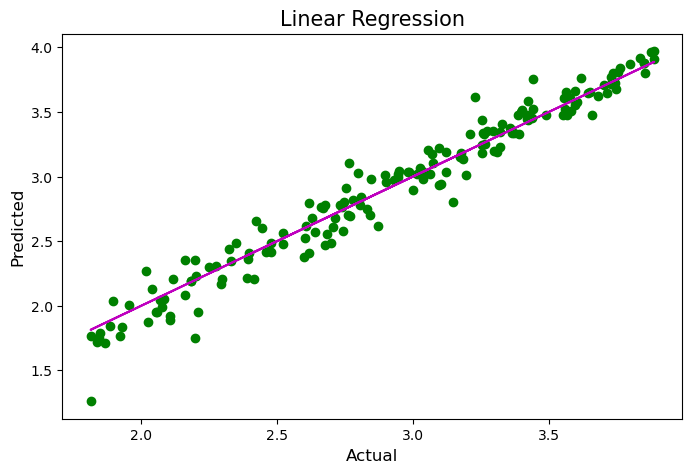

In [125]:
plt.figure(figsize=(8,5))
plt.scatter(x=pred,y=y_test,color='g')
plt.plot(pred,pred,color='m')
plt.xlabel("Actual",fontsize=12)
plt.ylabel("Predicted",fontsize=12)
plt.title("Linear Regression",fontsize=15)
plt.show()

# Save the model

In [122]:
import pickle
filename="Student grades prediction.pkl"
pickle.dump(Model,open(filename,'wb')) #saved model

In [123]:
import pickle
loaded_model=pickle.load(open("Student grades prediction.pkl",'rb'))
result=loaded_model.score(x_test,y_test)
print(result*100)

95.88594342673687


In [124]:
conclusion=pd.DataFrame([loaded_model.predict(x_test)[:],y_test[:]],index=["Predicted","Original"])
conclusion.head()

,0,1,2,3,4,5,6,7,8,9,...,162,163,164,165,166,167,168,169,170,171
Predicted,3.209185,2.415366,2.678095,2.160397,2.116715,2.478246,2.197126,3.602705,3.853399,3.390568,...,2.846804,3.096961,3.85108,3.849485,3.25699,2.797914,3.580545,3.069847,1.894822,2.394566
Original,3.332000,2.208000,2.468000,2.084000,2.206000,2.418000,2.352000,3.578000,3.798000,3.328000,...,2.982000,2.938000,3.87800,3.876000,3.33500,3.027000,3.504000,3.176000,2.040000,2.359000
